# ARIMA, Преобразование Бокса-Кокса <a class="tocSkip">

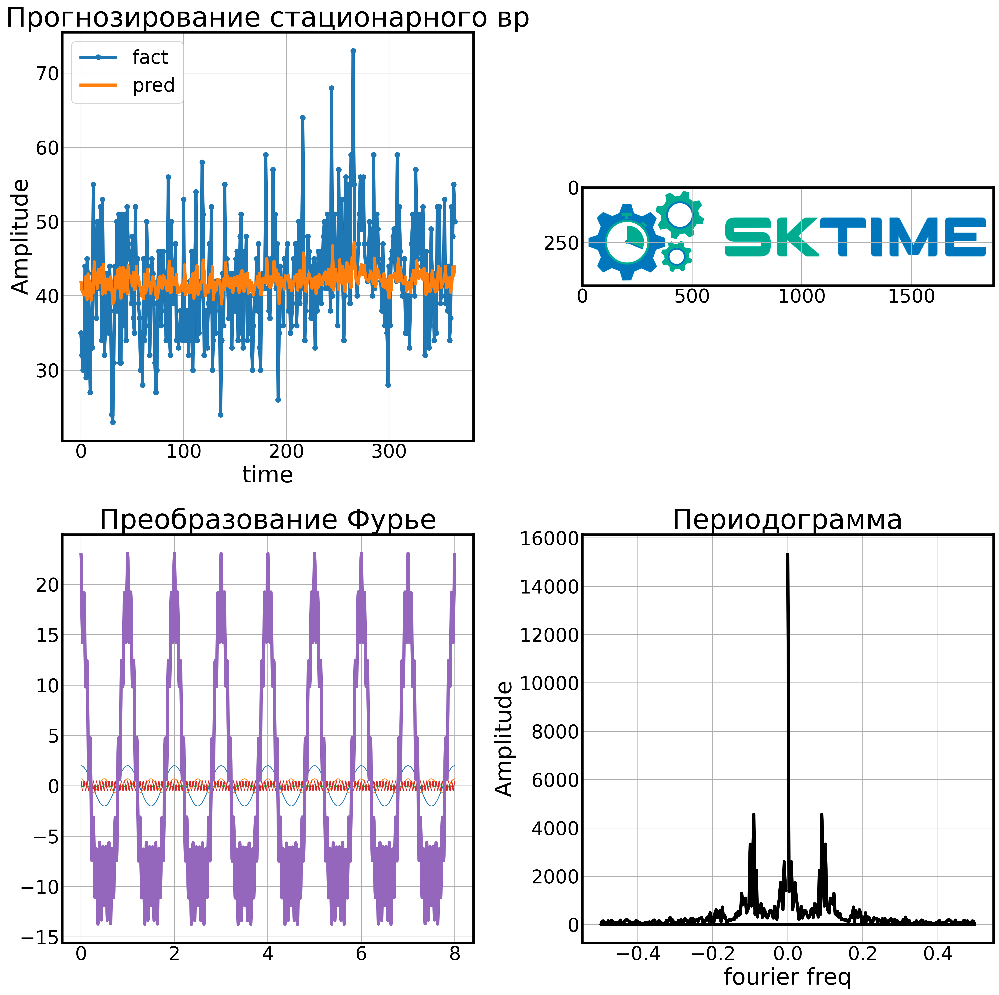

План текущего семинара:
1. Разбираем несколько примеров прогнозирования стационарных вр с помощью модели ARMA
2. Раскладываем вр в ряды Фурье, строим периодограммы, моделируем сезонность
3. Строим прогнозы вр с помощью stl-разложения

In [1]:
import matplotlib.pyplot as plt
import seaborn as sns

import numpy as np
import pandas as pd
import warnings
warnings.filterwarnings("ignore")
import statsmodels.api as sm
from scipy import stats
from statsmodels.graphics import tsaplots
from sktime.utils.plotting import plot_correlations
from itertools import product

In [2]:
import warnings
warnings.simplefilter("ignore")

In [3]:
params = {'lines.linewidth': 4,
          'lines.solid_capstyle': 'butt',
          'axes.labelsize': 'large',
          'axes.axisbelow': True,
          'axes.grid': True,
          'axes.linewidth': 3.0,
          'axes.titlesize': 'x-large',
          'grid.linestyle': '-',
          'grid.linewidth': 1.0,
          'xtick.major.size': 0,
          'xtick.minor.size': 0,
          'ytick.major.size': 0,
          'ytick.minor.size': 0,
          'figure.subplot.left': 0.08,
          'figure.subplot.right': 0.95,
          'figure.subplot.bottom': 0.07,
          'figure.figsize': (10.8, 7.8),
          'figure.autolayout': True,
          'figure.dpi': 300,
          'font.size': 24.0 }
plt.rcParams.update(params)

In [4]:
pd.options.display.max_rows = 999
%cd ..
%env PYTHONPATH=.

/home/dssaburi/projects/teta
env: PYTHONPATH=.


In [5]:
np.random.seed(555)

In [6]:
from sktime.performance_metrics.forecasting import MeanAbsoluteError,MeanAbsolutePercentageError
from sklearn.metrics import r2_score

def metrics_report(y_true,
                   y_pred
                  ):
    
    """
    Функция оценки качества прогноза. Оценивает персентили распределения ошибки 
    (медиану, среднее, 3й квартиль и 95-персентиль) 
    по абсолютной и относительной процентной ошибки для прогноза с помощью модели (y_pred) и
    для базового прогноза, равному среднему значению вр.
    
    """
    
    mape_func = MeanAbsolutePercentageError()
    mae_func = MeanAbsoluteError()
    
    y_true_mean = y_true.mean()*np.ones(shape=(len(y_true),))
    
    
    mapes = mape_func.evaluate_by_index(y_true,y_pred)*100
    maes = mae_func.evaluate_by_index(y_true,y_pred)
    
    
    mapes_zero = mape_func.evaluate_by_index(y_true,y_true_mean)*100
    maes_zero = mae_func.evaluate_by_index(y_true,y_true_mean)
    
    def quan_75(y,quan=0.75):
        return y.quantile(quan)

    def quan_95(y,quan=0.95):
        return y.quantile(quan)
    
    stats_list = ['mean','median',quan_75,quan_95,'std']
    
    res = pd.DataFrame([maes.agg(stats_list),
                        maes_zero.agg(stats_list),
                        mapes.agg(stats_list),
                        mapes_zero.agg(stats_list)],
                       index=['maes','maes_zero','mapes','mapes_zero'])
    
    res.loc["r2",:] = r2_score(y_true, y_pred)
    
    return res

In [7]:
from sktime.forecasting.arima import ARIMA
from sktime.forecasting.model_selection import ExpandingWindowSplitter
from sktime.forecasting.model_evaluation import evaluate
from sktime.forecasting.arima import AutoARIMA
from scipy.stats import ttest_1samp, shapiro
from statsmodels. tsa.stattools import adfuller, kpss
from statsmodels.graphics.gofplots import qqplot
from statsmodels.stats.diagnostic import acorr_ljungbox, het_breuschpagan

In [8]:
def calc_optimum_arma(ts,
                      max_p,
                       max_q): 
    """
    Подбор оптимальных гиперпараметров модели ARMA с помощью критерия Акаике.
    Идет перебор всех вариантов (p,q) в пределах (0,max_p)*(0,max_q)
    
    """
    
    best_bic = float("inf")
    
    ps = range(0, max_p+1)
    qs = range(0, max_q+1)
    parameters = product(ps, qs)
    parameters_list = list(parameters)
    
    print(len(parameters_list))
    
    results = []
    for param in parameters_list:
        #try except нужен, потому что на некоторых наборах параметров модель не обучается
        try:
            model=ARIMA(order=(param[0], 0, param[1])).fit(ts)
        #выводим параметры, на которых модель не обучается и переходим к следующему набору
        except ValueError:
            print('wrong parameters:', param)
            continue
        aic = model._forecaster.aic()
        bic = model._forecaster.bic()
        #сохраняем лучшую модель, aic, параметры
        if bic < best_bic:
            best_model = model
            best_bic = aic
            best_param = param
        results.append([param, aic, bic]) 
    
    return results, best_model
    

In [9]:
def check_fit(resids):
    
    """
    Проверка остатков на равенство нулю среднего, на стационарность, нормальность, отсутствие автокорреляций и 
    гомоскедастичность.
    """
    
    #mean = 0
    mean_t, mean_pval = ttest_1samp(resids,0)

    # stationary
    stat_t, stat_pval = adfuller(resids,maxlag=6)[:2]

    # normality 
    norm_t, norm_pval = shapiro(resids)
    
    # autocorr 
    autocor_pval = (acorr_ljungbox(resids,model_df=0,return_df=False)['lb_pvalue'] <0.05).sum()==0
    
    # heteroscedasticity  
    lm, lm_pval, ff, ff_pval = \
    het_breuschpagan(resids,sm.add_constant(resids.reset_index().index))

    records = {
        "mean_resids" : np.mean(resids),
        "mean_t" : mean_t,
        "mean_pval" : mean_pval,
        "stationary_t" : stat_t,
        "stationary_pval": 1 - stat_pval, # поменяли знак, чтобы желаемый результат всех проверок p_value>0.05 
        'autocor_pval': autocor_pval,
        "norm_t" : norm_t,
        "norm_pval" : norm_pval,
        "heteroscedasticity_t" : ff,
        "heteroscedasticity_pval" : ff_pval,
        "check_result" : (mean_pval>0.05) & (stat_pval<0.05) & (norm_pval>0.05) &\
        (ff_pval>0.05) & autocor_pval
       }
    
    return records

In [10]:
def plot_diagnostics(data, dt_col,resid_col):
    
    """
    Строим визуальную оценку остатков - остатки as-is, гистограмма остатков, qqplot и автокореляционную функцию.
    """
    
    fig,ax = plt.subplots(2,2,figsize=(15,10))

    # resid as-is
    sns.lineplot(data=data, x=dt_col, y=resid_col, ax=ax[0][0]);
    ax[0][0].axhline(0, c="k", linestyle="--")
    ax[0][0].set_title("Динамика ошибок прогноза")
    ax[0][0].set_xlabel(None)
    ax[0][0].set_ylabel(None)
    ax[0][0].xaxis.set_major_locator(plt.MaxNLocator(4))

    #hist
    sns.histplot(data=data,x=resid_col,ax=ax[0][1]);
    ax[0][1].set_title("Гистограмма ошибок прогноза")
    ax[0][1].set_xlabel(None)
    ax[0][1].set_ylabel(None)

    #acf
    sm.graphics.tsa.plot_acf(data[resid_col], lags=10,ax=ax[1][0]);
    ax[1][0].set_title("Автокореляции ошибок прогноза")
    ax[1][0].set_xlabel(None)
    ax[1][0].set_ylabel(None)

    #qq
    qqplot(data[resid_col],line='s',ax=ax[1][1]);
    ax[1][1].set_title("Q-q график ошибок прогноза")
    ax[1][1].set_xlabel(None)
    ax[1][1].set_ylabel(None)

In [11]:
np.random.seed(20)

# Прогнозирование стационарных вр

В этом разделе потренируемся подбирать оптимальные гиперпараметры для моделей ARMA.

Обратите внимание, что в этом разделе мы подбираем гиперпараметры по всему вр, что, строго говоря, не совсем корректно, т.к. в этом случае мы допускаем "утечку" данных - подбираем параметры по данным, которых мы еще не видели.

## Искусственный ряд ARMA

In [12]:
arma33_model = sm.tsa.ArmaProcess(ar=[1,0.5,0.55,0.2],ma=[1, -0.4, 0.3, -0.9],nobs=10000)
arma33_ts = pd.Series(arma33_model.generate_sample(500,burnin=10000))

<Axes: >

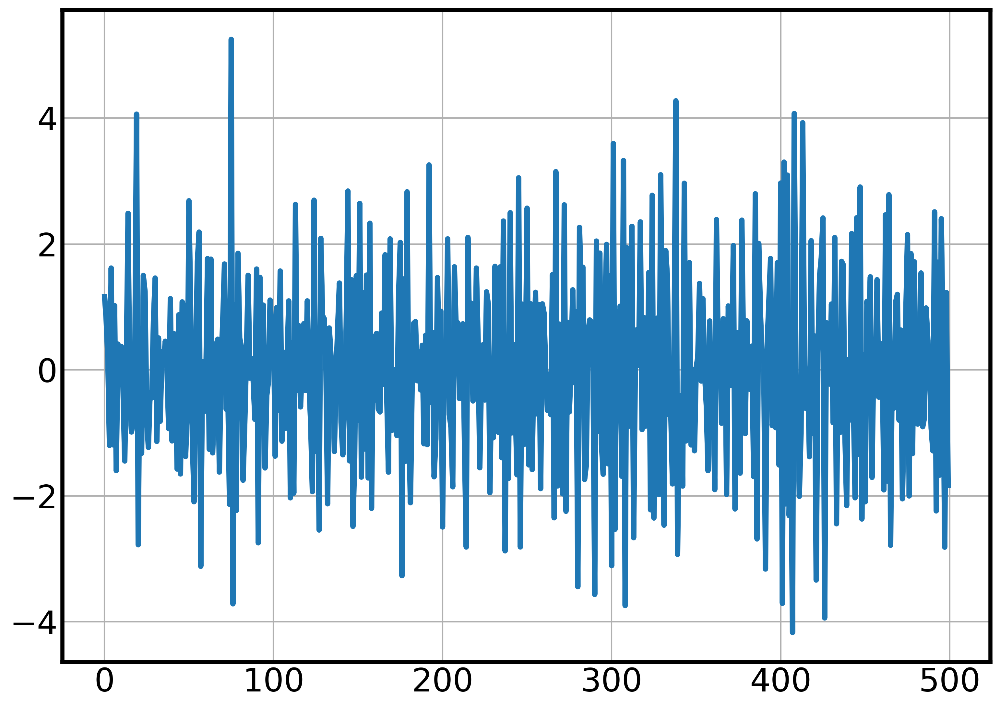

In [13]:
arma33_ts.plot()

In [14]:
# проверяем, что ряд стационарный
adfuller(arma33_ts)[1]

5.901968163518418e-21

In [15]:
# отложим последние 50 точек в тестовую выборку
train_idx = 450

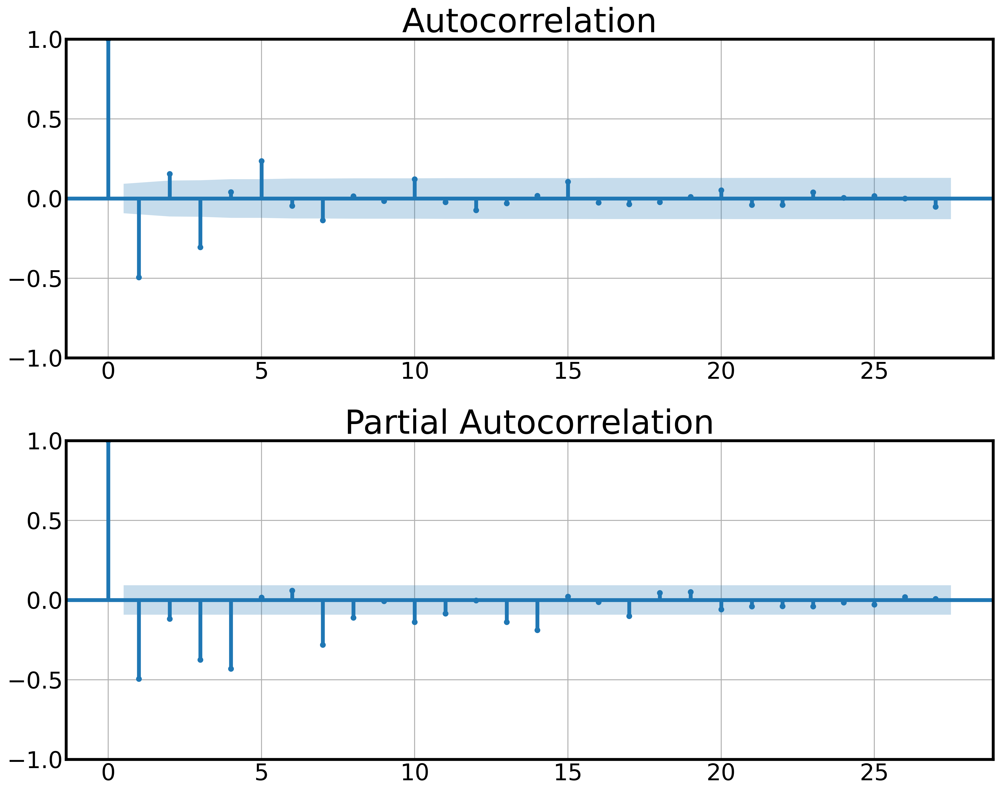

In [17]:
# подберем максимальные значения для p и q
# здесь правильно подбираем гиперпараметры
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(arma33_ts.iloc[:train_idx],ax=ax[0]);
tsaplots.plot_pacf(arma33_ts.iloc[:train_idx],ax=ax[1]);

In [20]:
# на ЧАКФ 4 первых лага статзначимо отличны от нуля - соответственно, максимальный порядок ar части p - 4
# на АКФ 3 первых лага + 5й статзначимо отличны от нуля - возьмем максимальный порядок ma части q с запасом - 5
params, arima = calc_optimum_arma(arma33_ts,3,5)

24


In [21]:
arima.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                  500
Model:               SARIMAX(2, 0, 4)   Log Likelihood                -711.984
Date:                Sat, 04 May 2024   AIC                           1439.967
Time:                        00:17:25   BIC                           1473.684
Sample:                             0   HQIC                          1453.198
                                - 500                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0005      0.001      0.566      0.572      -0.001       0.002
ar.L1         -0.1398      0.082     -1.697      0.090      -0.301       0.022
ar.L2         -0.4908      0.050     -9.739      0.000      -0.590      -0.392
ma.L1         -0.6897      0.089     -7.769      0.000      -0.864      -0.516
ma.L2          0.4962      0.045     10.955      0.000       0.407       0.585
ma.L3         -1.0308      0.036    -28.533      0.000      -1.102      -0.960
ma.L4          0.2388      0.081      2.963      0.003       0.081       0.397
sigma2         0.9801      0.058     16.923      0.000       0.867       1.094
===================================================================================
Ljung-Box (L1) (Q):                   0.55   Jarque-Bera (JB):                 3.13
Prob(Q):                              0.46   Prob(JB):                         0.21
Heteroskedasticity (H):               1.41   Skew:                            -0.06
Prob(H) (two-sided):                  0.03   Kurtosis:                         3.37
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

Теперь потренеруемся оценивать качество моделей на кросс-валидации с помощью библиотеки sktime. 

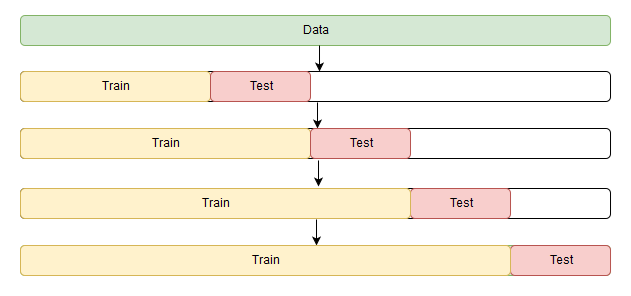

In [22]:
# Попробуем оценить качество прогнозов на 1 и 3 шага вперед с помощью расширяющегося скользящего окна (см. рис выше)
splitter1 = ExpandingWindowSplitter(fh=1,initial_window=train_idx,step_length=1)
splitter3 = ExpandingWindowSplitter(fh=3,initial_window=train_idx,step_length=1)

In [23]:
forecaster = ARIMA((2,0,4))

In [24]:
# воспользуемся функцией evaluate, чтобы получить предикты на кросс-валидации
# 2 прогноза на 50 точек с переобучением нбегут полторы минуты!
df1 = evaluate(forecaster=forecaster, 
              y=arma33_ts, 
              cv=splitter1, 
              strategy="refit", 
              return_data=True)

df3 = evaluate(forecaster=forecaster, 
              y=arma33_ts, 
              cv=splitter3, 
              strategy="refit", 
              return_data=True)

In [25]:
df1.head()

,test_MeanAbsolutePercentageError,fit_time,pred_time,len_train_window,cutoff,y_train,y_test,y_pred
0,0.958183,1.302008,0.013448,450,449,0 1.207619 1 0.818860 2 0.20322...,450 -2.093331 dtype: float64,450 -0.087536 dtype: float64
1,0.796879,1.327773,0.011632,451,450,0 1.207619 1 0.818860 2 0.20322...,451 1.088567 dtype: float64,451 1.956023 dtype: float64
2,0.412217,1.351856,0.011244,452,451,0 1.207619 1 0.818860 2 0.20322...,452 0.713832 dtype: float64,452 0.419578 dtype: float64
3,0.434073,1.316751,0.012609,453,452,0 1.207619 1 0.818860 2 0.20322...,453 1.479324 dtype: float64,453 0.83719 dtype: float64
4,0.766258,1.296257,0.012064,454,453,0 1.207619 1 0.818860 2 0.20322...,454 -1.70578 dtype: float64,454 -0.398712 dtype: float64


In [26]:
df3.head()

,test_MeanAbsolutePercentageError,fit_time,pred_time,len_train_window,cutoff,y_train,y_test,y_pred
0,0.945206,1.248133,0.011528,450,449,0 1.207619 1 0.818860 2 0.20322...,452 0.713832 dtype: float64,452 0.039114 dtype: float64
1,0.187291,1.306936,0.011131,451,450,0 1.207619 1 0.818860 2 0.20322...,453 1.479324 dtype: float64,453 1.20226 dtype: float64
2,1.025833,1.326557,0.011110,452,451,0 1.207619 1 0.818860 2 0.20322...,454 -1.70578 dtype: float64,454 0.044065 dtype: float64
3,4.690534,1.281677,0.011429,453,452,0 1.207619 1 0.818860 2 0.20322...,455 0.263371 dtype: float64,455 -0.971979 dtype: float64
4,0.308518,1.270125,0.011103,454,453,0 1.207619 1 0.818860 2 0.20322...,456 -0.387308 dtype: float64,456 -0.267817 dtype: float64


In [27]:
# как видно из содержания df1 и df3 выше, в колонках  y_train,y_test,y_pred лежат pd.Series, 
# для удобства приводим их к обычным числам
df1['y_pred'] = df1['y_pred'].apply(lambda x: x.values[0]) 
df1['y_test'] = df1['y_test'].apply(lambda x: x.values[0]) 

df3['y_pred'] = df3['y_pred'].apply(lambda x: x.values[0]) 
df3['y_test'] = df3['y_test'].apply(lambda x: x.values[0]) 

df1['resid'] = df1['y_test'] - df1['y_pred']
df3['resid'] = df3['y_test'] - df3['y_pred']

<Axes: >

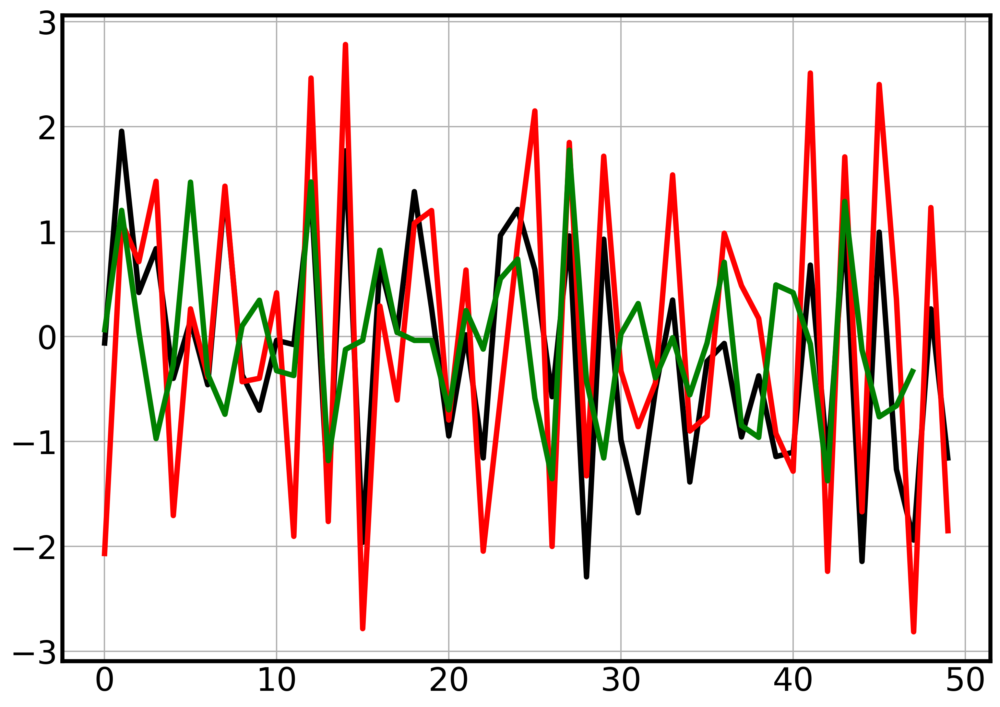

In [28]:
# начертим на одном графике прогнозы и факты
df1['y_pred'].plot(c='black')
df1['y_test'].plot(c='red')
df3['y_pred'].plot(c='green')

визуально качество прогнозов оценить сложно, оценим качество остатков и метрики прогнозов

In [29]:
# при прогнозе на 1 шаг вперед остатки обладают всеми необходимыми свойствами
check_fit(df1['resid'])

{'mean_resids': 0.1472912573592436,
 'mean_t': 1.112807242380728,
 'mean_pval': 0.27122083773406636,
 'stationary_t': -7.990986208716174,
 'stationary_pval': 0.9999999999975251,
 'autocor_pval': True,
 'norm_t': 0.9745148420333862,
 'norm_pval': 0.34965696930885315,
 'heteroscedasticity_t': 0.2908041682824997,
 'heteroscedasticity_pval': 0.5921983875132389,
 'check_result': True}

In [30]:
# при прогнозе на 3 шага вперед появляются остаточные корреляции
check_fit(df3['resid'])

{'mean_resids': 0.05732870896544732,
 'mean_t': 0.3073652505469628,
 'mean_pval': 0.7599232342637772,
 'stationary_t': -5.521047527110821,
 'stationary_pval': 0.9999981226597964,
 'autocor_pval': False,
 'norm_t': 0.9861524701118469,
 'norm_pval': 0.8366251587867737,
 'heteroscedasticity_t': 0.6835295607129525,
 'heteroscedasticity_pval': 0.4126420811995807,
 'check_result': False}

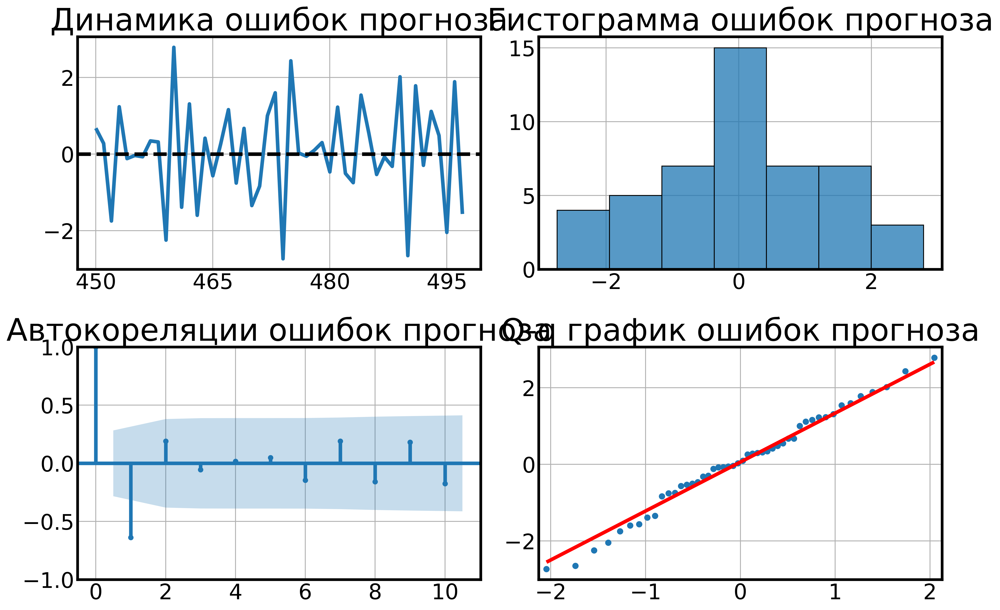

In [31]:
plot_diagnostics(df3,'len_train_window','resid')

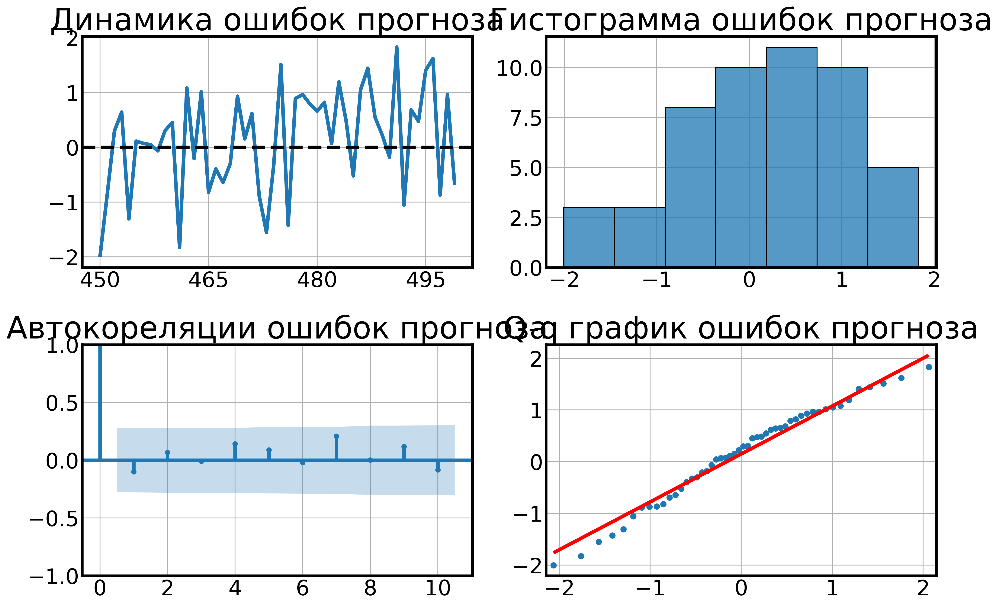

In [32]:
plot_diagnostics(df1,'len_train_window','resid')

теперь сравним метрики качества прогноза

In [33]:
metrics_report(df1['y_test'].values, df1['y_pred'].values)

,mean,median,quan_75,quan_95,std
maes,0.786045,0.741817,1.054119,1.734387,0.517321
maes_zero,1.295132,1.236617,1.866647,2.658365,0.768186
mapes,81.074328,56.259517,91.619781,281.910143,85.927343
mapes_zero,100.248815,100.004273,101.802387,106.876779,3.668845
r2,0.609813,0.609813,0.609813,0.609813,0.609813


In [34]:
metrics_report(df3['y_test'].values, df3['y_pred'].values)

,mean,median,quan_75,quan_95,std
maes,1.005322,0.753731,1.574941,2.578693,0.800640
maes_zero,1.282807,1.216591,1.856634,2.687297,0.775308
mapes,91.001960,84.827968,113.306637,155.454304,78.188710
mapes_zero,100.019128,100.000342,100.142469,100.560920,0.298507
r2,0.266689,0.266689,0.266689,0.266689,0.266689


Метрики при прогнозе на 1 шаг вперед ожидаемо лучше. Ухудшение связано с отсутствием информации о первом и втором лагах для модели МА. Тем не менее, даже такие прогнозы значительно лучше среднего по вр

## Среднегодовой сток реки Рейн около Базеля, Швейцария, 1807–1957 гг. (150 записей)

In [32]:
river = pd.read_csv('data/rhine_river_discharge.csv',index_col='Year',parse_dates=True)
river.index.freq = 'AS'
river.head()

,Discharge
Year,
1807-01-01,864.884
1808-01-01,1033.141
1809-01-01,826.923
1810-01-01,1018.777
1811-01-01,1118.296


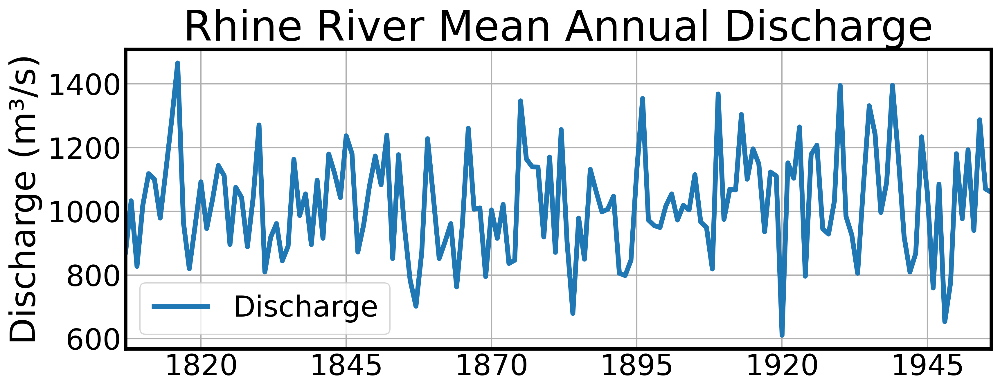

In [33]:
title = 'Rhine River Mean Annual Discharge'
ylabel='Discharge (m³/s)'
xlabel='' 

ax = river.plot(figsize=(12,5),title=title)
ax.autoscale(axis='x',tight=True)
ax.set(xlabel=xlabel, ylabel=ylabel);

In [34]:
# проверяем, что ряд стационарный
adfuller(river)[1]

1.5643075750689002e-20

In [35]:
# центрируем ряд
river_zero = river - river.mean()

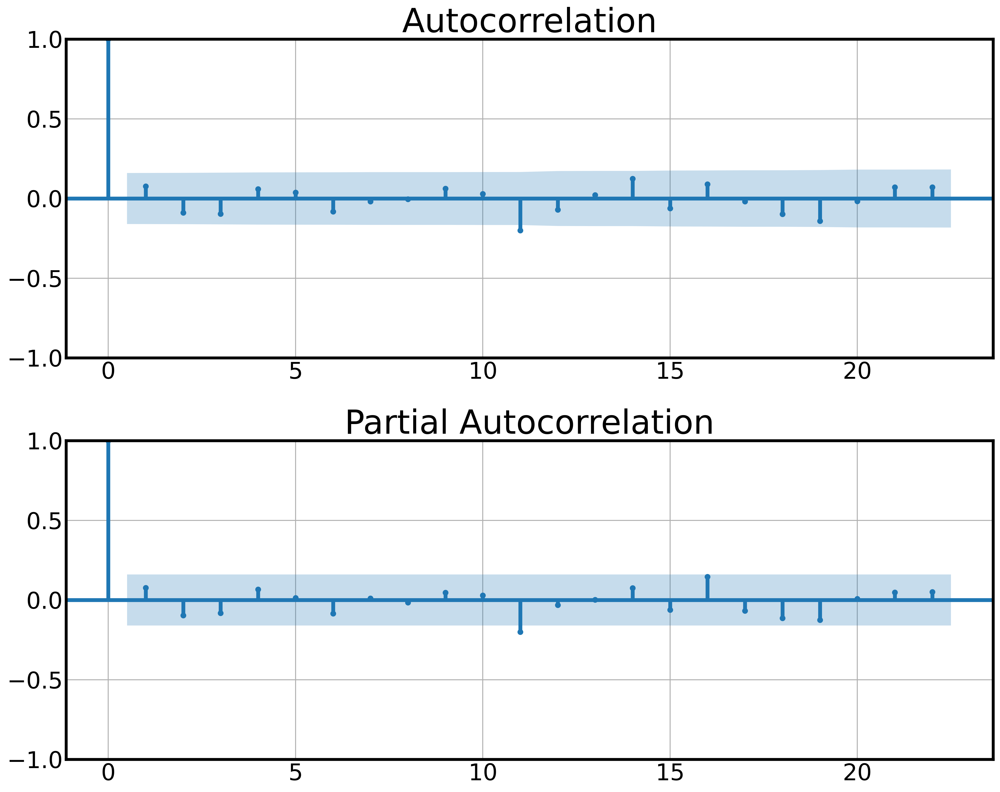

In [36]:
# подберем максимальные значения для p и q
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(river_zero,ax=ax[0]);
tsaplots.plot_pacf(river_zero,ax=ax[1]);

автокореляции отсутствуют, перед нами график белого шума

In [37]:
# проверяем свойства белого шума
check_fit(river_zero)

{'mean_resids': Discharge   -2.645114e-13
 dtype: float64,
 'mean_t': array([-1.98307313e-14]),
 'mean_pval': array([1.]),
 'stationary_t': -11.267733514756763,
 'stationary_pval': 1.0,
 'autocor_pval': True,
 'norm_t': 0.9956402778625488,
 'norm_pval': 0.9380543828010559,
 'heteroscedasticity_t': 2.503107654694072,
 'heteroscedasticity_pval': 0.11575657185972259,
 'check_result': array([ True])}

In [38]:
# если мы, вопреки здравому смыслу, попробуем подобрать модель arma, скажем, вплоть до 4го порядка
params, arima = calc_optimum_arma(river_zero,4,4)

25


In [39]:
# то удивим, что в топе оказалась модель именно белого шума 
arima.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                  150
Model:                        SARIMAX   Log Likelihood                -976.734
Date:                Thu, 02 May 2024   AIC                           1957.469
Time:                        22:50:45   BIC                           1963.490
Sample:                    01-01-1807   HQIC                          1959.915
                         - 01-01-1956                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept  -2.645e-13     13.372  -1.98e-14      1.000     -26.208      26.208
sigma2      2.651e+04   3245.018      8.169      0.000    2.01e+04    3.29e+04
===================================================================================
Ljung-Box (L1) (Q):                   0.89   Jarque-Bera (JB):                 0.77
Prob(Q):                              0.35   Prob(JB):                         0.68
Heteroskedasticity (H):               1.69   Skew:                             0.14
Prob(H) (two-sided):                  0.07   Kurtosis:                         2.80
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

## Кол-во рожденных девушек в штате Калифорния за 1959 год

In [40]:
dffem = pd.read_csv('data/daily-total-female-births.csv',index_col='Date',parse_dates=True)
dffem.index.freq = 'D'
dffem.head()

,Births
Date,
1959-01-01,35
1959-01-02,32
1959-01-03,30
1959-01-04,31
1959-01-05,44


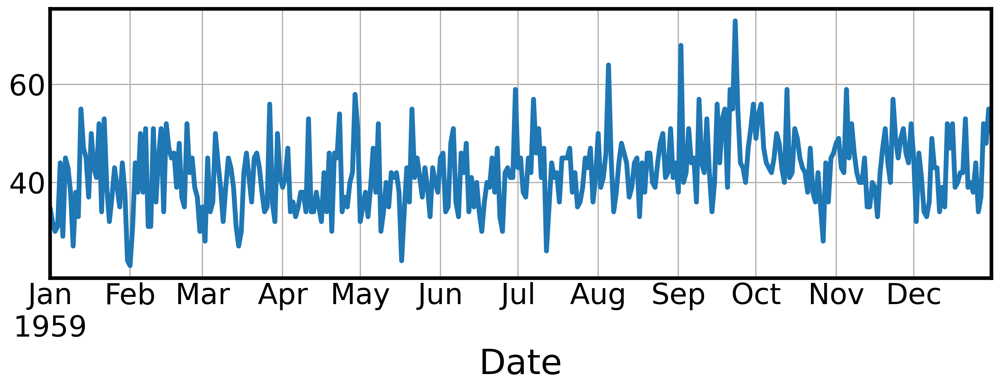

In [41]:
dffem['Births'].plot(figsize=(12,5));

In [42]:
# проверяем, что ряд стационарный
adfuller(dffem)[1]

5.243412990149787e-05

In [43]:
# центрируем ряд
dffem_zero = dffem['Births'] - dffem['Births'].mean()

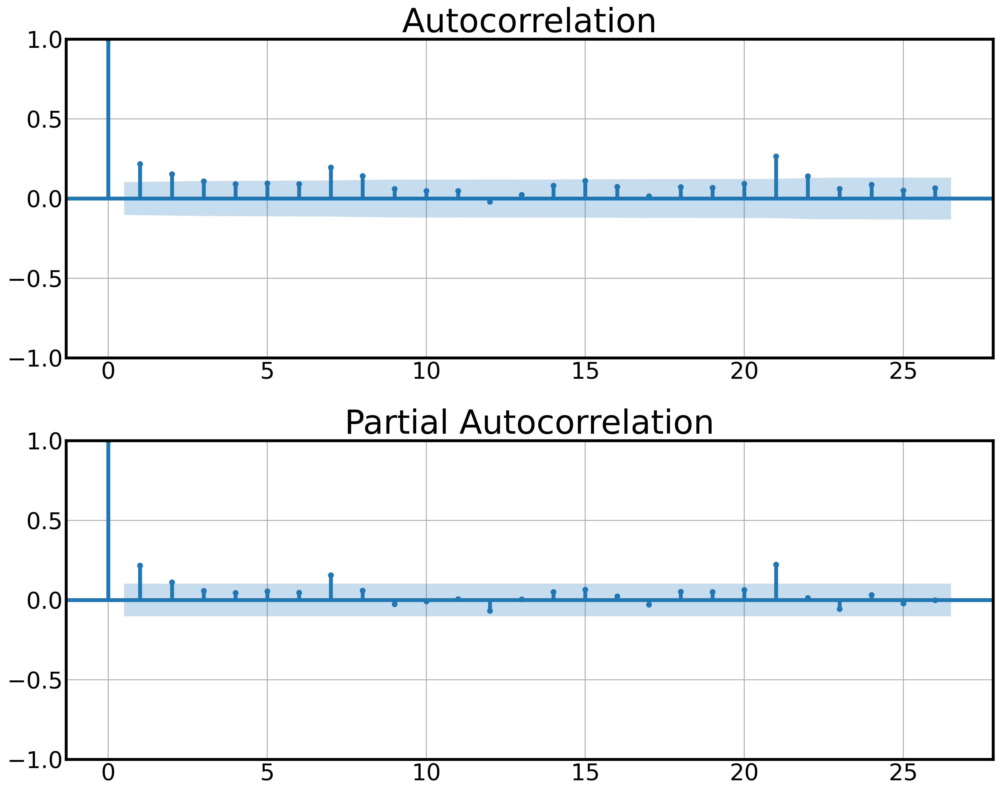

In [44]:
# подберем максимальные значения для p и q
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(dffem_zero,ax=ax[0]);
tsaplots.plot_pacf(dffem_zero,ax=ax[1]);

In [45]:
# и в автокореляции и в частичной автокорреляции отличны от нуля первые 2 лага
model_dffem = calc_optimum_arma(dffem,2,2)[1]

9


In [46]:
model_dffem.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                  365
Model:               SARIMAX(0, 0, 1)   Log Likelihood               -1238.270
Date:                Thu, 02 May 2024   AIC                           2482.539
Time:                        22:50:51   BIC                           2494.239
Sample:                    01-01-1959   HQIC                          2487.189
                         - 12-31-1959                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     41.9809      0.468     89.628      0.000      41.063      42.899
ma.L1          0.1782      0.053      3.333      0.001       0.073       0.283
sigma2        51.7836      3.440     15.052      0.000      45.041      58.526
===================================================================================
Ljung-Box (L1) (Q):                   0.19   Jarque-Bera (JB):                24.38
Prob(Q):                              0.66   Prob(JB):                         0.00
Heteroskedasticity (H):               1.01   Skew:                             0.51
Prob(H) (two-sided):                  0.97   Kurtosis:                         3.75
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

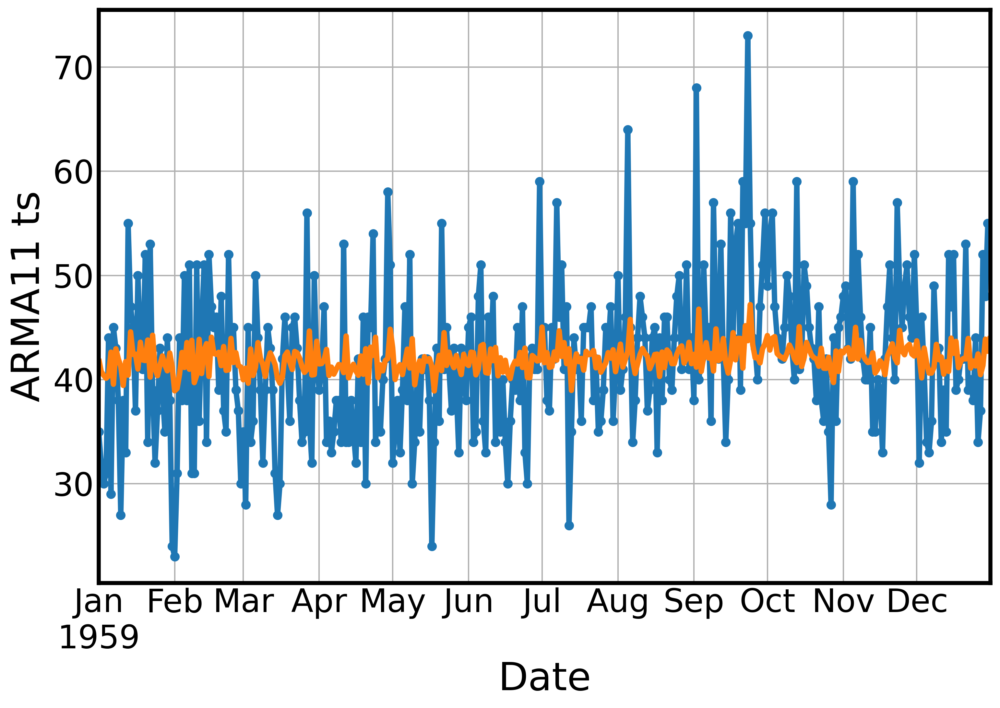

In [47]:
# начертим на одном графике факты и результат модели на обучающей выборке
ax = dffem.plot(legend=False,marker='o')
ax.plot(model_dffem._forecaster.fittedvalues())
ax.set_ylabel('ARMA11 ts');

Видим, что модель получилась довольно простая. Давайте проверим, сохранилось ли в остатках еще какая-то информация для прогноза

<Axes: xlabel='Date'>

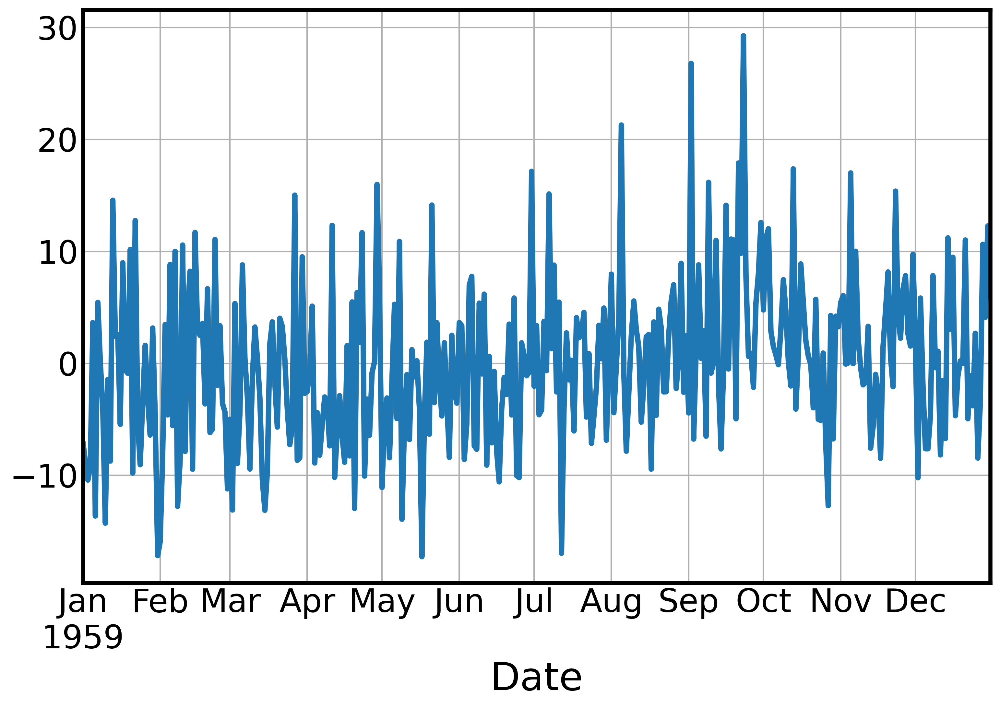

In [48]:
model_dffem._forecaster.resid().plot()

In [49]:
# проверка остатков говорит о наличии остаточных корреляций
check_fit(model_dffem._forecaster.resid())

{'mean_resids': 0.0022262527790239614,
 'mean_t': 0.00590216011731991,
 'mean_pval': 0.9952940182199019,
 'stationary_t': -5.043927909635637,
 'stationary_pval': 0.9999818459962742,
 'autocor_pval': False,
 'norm_t': 0.9841632843017578,
 'norm_pval': 0.0004926596884615719,
 'heteroscedasticity_t': 0.66453545854402,
 'heteroscedasticity_pval': 0.4154978319769371,
 'check_result': False}

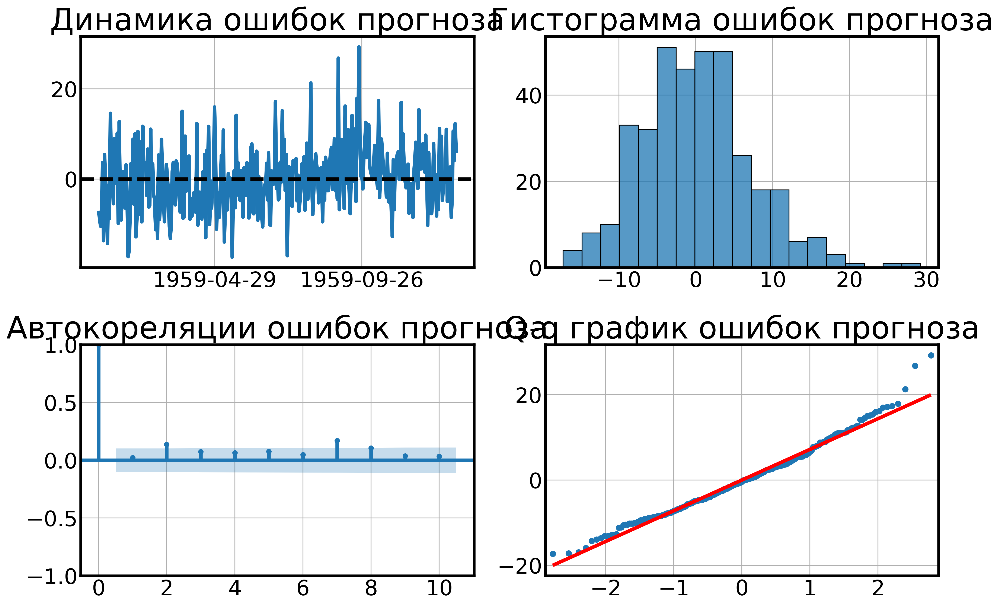

In [50]:
plot_diagnostics(model_dffem._forecaster.resid().reset_index(),'Date',0)

In [51]:
# видим наличии корреляций после 1го лага
acorr_ljungbox(model_dffem._forecaster.resid(),return_df=True) 

,lb_stat,lb_pvalue
1,0.191970,0.661282
2,7.222893,0.027013
3,9.257632,0.026055
4,10.868201,0.028086
5,13.053482,0.022883
6,13.939518,0.030319
7,24.746548,0.000841
8,28.981927,0.000319
9,29.510058,0.000531
10,29.926700,0.000881


Раз имеются остаточные корреляции - давайте попробуем их использовать. Для этого будем работать с рядом остатков прогноза от модели MA(1)

In [52]:
resid_series = model_dffem._forecaster.resid()

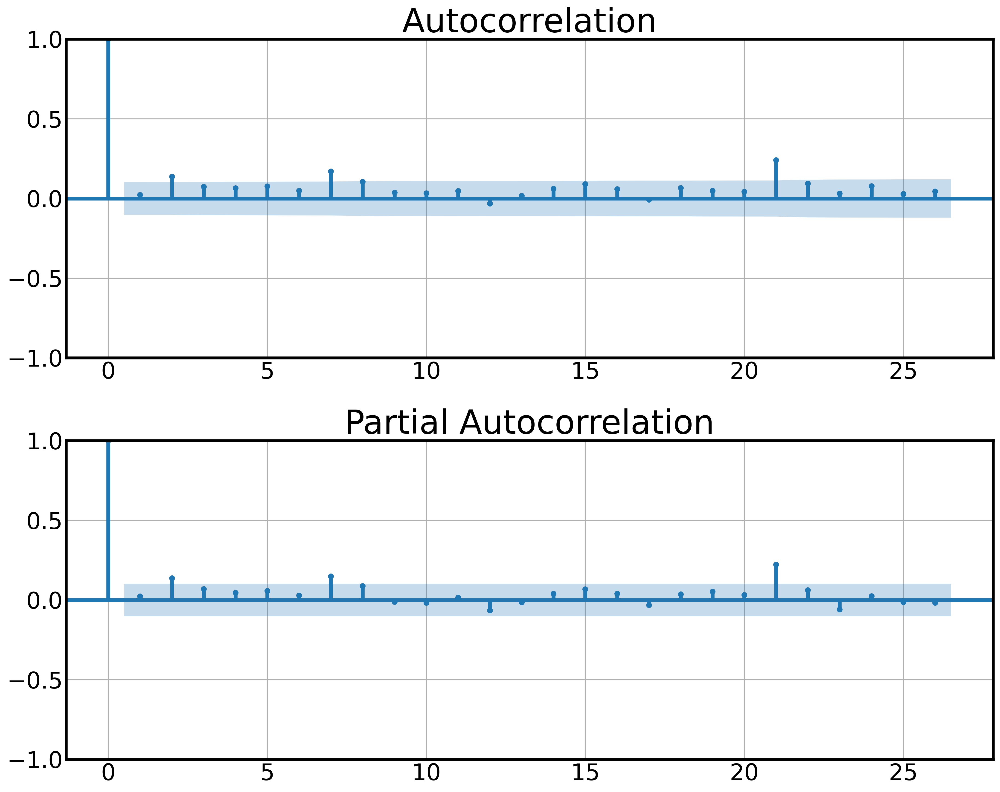

In [53]:
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(resid_series,ax=ax[0]);
tsaplots.plot_pacf(resid_series,ax=ax[1]);

In [54]:
# по королеллограмме видим, что значимо отличны от 0 лаг 7, давайте попробуем учесть его в модели 
model_dffem = calc_optimum_arma(resid_series,7,7)[1]

64


In [55]:
# оптимальной моделью получилась модель белого шума
model_dffem.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                  365
Model:                        SARIMAX   Log Likelihood               -1238.269
Date:                Thu, 02 May 2024   AIC                           2480.537
Time:                        22:51:59   BIC                           2488.337
Sample:                    01-01-1959   HQIC                          2483.637
                         - 12-31-1959                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0022      0.396      0.006      0.996      -0.774       0.778
sigma2        51.7879      3.439     15.060      0.000      45.048      58.528
===================================================================================
Ljung-Box (L1) (Q):                   0.19   Jarque-Bera (JB):                24.37
Prob(Q):                              0.66   Prob(JB):                         0.00
Heteroskedasticity (H):               1.01   Skew:                             0.51
Prob(H) (two-sided):                  0.98   Kurtosis:                         3.75
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [56]:
# А что будет, если мы все таки попробуем учесть этот выделяющийся лаг?
# Определим модель порядка (7,7)
forecaster = ARIMA((7,0,7))

In [57]:
forecaster.fit(resid_series)

ARIMA(order=(7, 0, 7))

<Axes: xlabel='Date'>

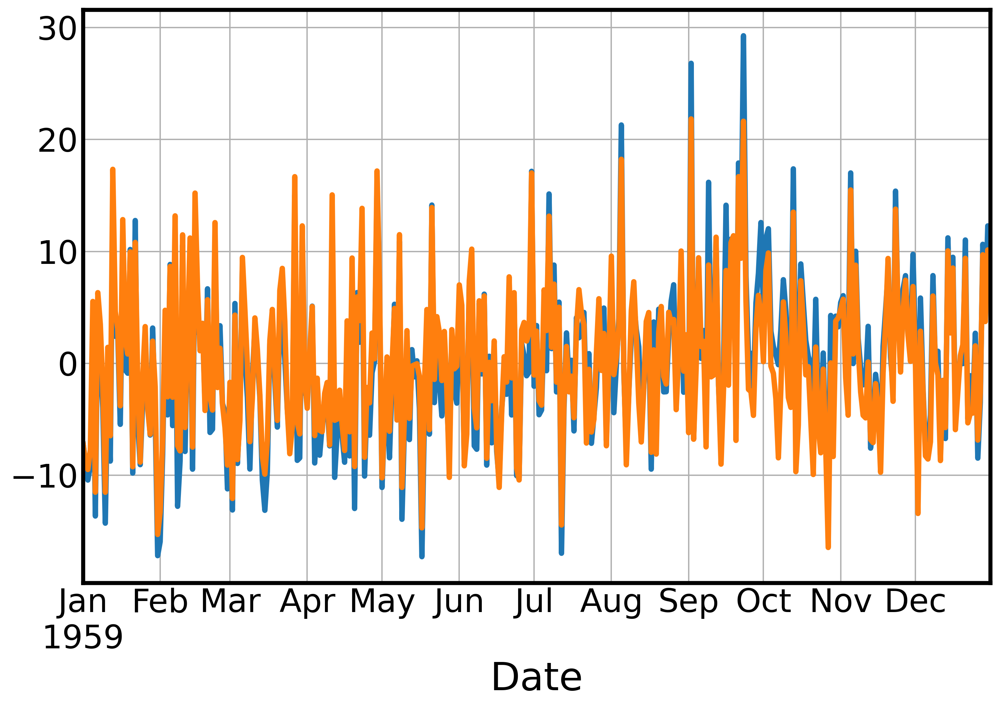

In [58]:
resid_series.plot()
forecaster._forecaster.resid().plot()

In [59]:
forecaster.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                  365
Model:               SARIMAX(7, 0, 7)   Log Likelihood               -1218.324
Date:                Thu, 02 May 2024   AIC                           2468.649
Time:                        22:52:02   BIC                           2531.047
Sample:                    01-01-1959   HQIC                          2493.446
                         - 12-31-1959                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0030      0.103      0.029      0.977      -0.198       0.204
ar.L1          0.2581      0.228      1.133      0.257      -0.188       0.705
ar.L2         -0.1275      0.247     -0.517      0.605      -0.611       0.356
ar.L3         -0.0700      0.261     -0.269      0.788      -0.581       0.441
ar.L4          0.1735      0.258      0.672      0.501      -0.332       0.679
ar.L5         -0.2487      0.244     -1.019      0.308      -0.727       0.229
ar.L6          0.2772      0.228      1.213      0.225      -0.171       0.725
ar.L7          0.6628      0.218      3.041      0.002       0.236       1.090
ma.L1         -0.3111      0.250     -1.245      0.213      -0.801       0.178
ma.L2          0.2423      0.270      0.897      0.370      -0.287       0.772
ma.L3          0.0587      0.292      0.201      0.841      -0.514       0.631
ma.L4         -0.1225      0.289     -0.424      0.671      -0.688       0.443
ma.L5          0.2827      0.278      1.017      0.309      -0.262       0.827
ma.L6         -0.3324      0.254     -1.307      0.191      -0.831       0.166
ma.L7         -0.5247      0.239     -2.193      0.028      -0.994      -0.056
sigma2        46.0579      4.262     10.806      0.000      37.704      54.412
===================================================================================
Ljung-Box (L1) (Q):                   0.01   Jarque-Bera (JB):                11.56
Prob(Q):                              0.92   Prob(JB):                         0.00
Heteroskedasticity (H):               0.93   Skew:                             0.44
Prob(H) (two-sided):                  0.69   Kurtosis:                         3.05
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [60]:
# мы избавились от автокореляций, но теперь распределение остатков не нормально
check_fit(forecaster._forecaster.resid())

{'mean_resids': 0.11280193421126458,
 'mean_t': 0.3156232013986541,
 'mean_pval': 0.7524694073368696,
 'stationary_t': -18.94566383555406,
 'stationary_pval': 1.0,
 'autocor_pval': True,
 'norm_t': 0.9863341450691223,
 'norm_pval': 0.0016128423158079386,
 'heteroscedasticity_t': 1.4493096366468956,
 'heteroscedasticity_pval': 0.22942320355758078,
 'check_result': False}

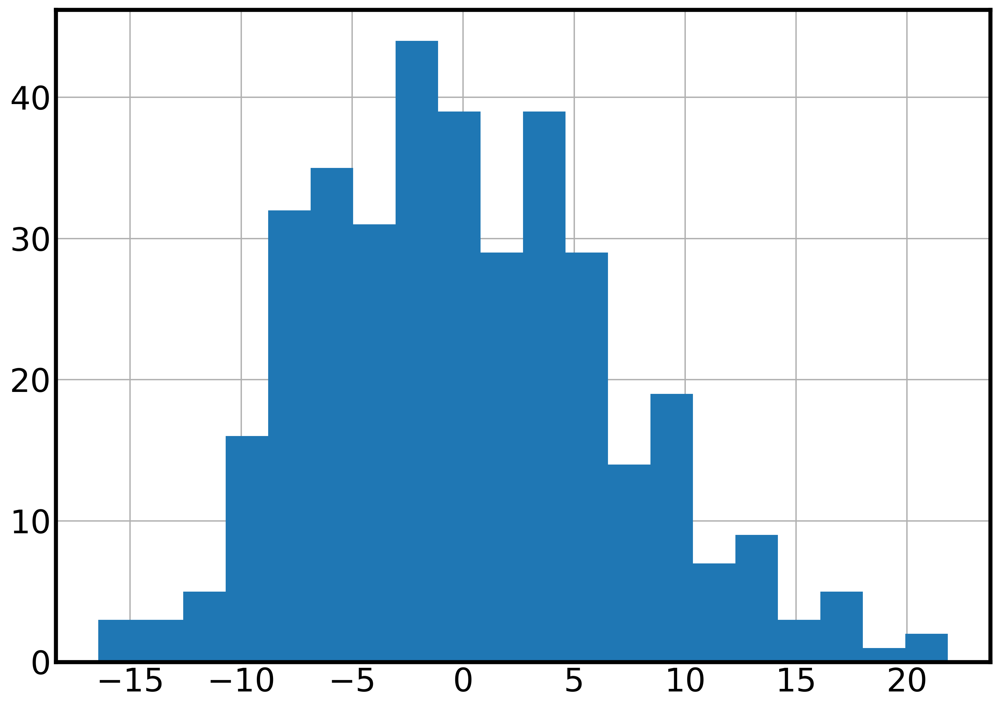

In [61]:
plt.hist(forecaster._forecaster.resid(),bins=20);

Станет ли наш прогноз лучше при использовании 2х моделей? Давайте проверим на кросс-валидации с шагом 1

In [62]:
initial_window = 270

In [63]:
splitter = ExpandingWindowSplitter(fh=1,initial_window=initial_window,step_length=1)

In [64]:
# базовая модель
model_dffem = ARIMA((0,0,1))

In [65]:
df1progn = evaluate(forecaster=forecaster, 
              y=dffem, 
              cv=splitter, 
              strategy="refit", 
              return_data=True)

In [66]:
# в колонках  y_train,y_test,y_pred лежат pd.Series, для удобства приводим их к обычным числам
df1progn['y_pred'] = df1progn['y_pred'].apply(lambda x: x.values[0][0]) 
df1progn['y_test'] = df1progn['y_test'].apply(lambda x: x.values[0][0]) 
df1progn['resid'] = df1progn['y_pred'] - df1progn['y_test']

In [67]:
model_dffem.fit(dffem)

ARIMA(order=(0, 0, 1))

In [68]:
# модель для остатков с лагом 7
model_dffem_resid = ARIMA((7,0,7))

In [69]:
# обратите внимание, что остатки мы считаем по прогнозам ма(1) 
# на обучающей выборке - model_dffem._forecaster.fittedvalues()
# иллюстративно нам хватит такого примера, но для стекинга прогнозов нужно обучаться 
# на остатках, полученных в результате кросс-валидации
df1resid = evaluate(forecaster=model_dffem_resid, 
              y=resid_series, 
              cv=splitter, 
              strategy="refit", 
              return_data=True)

In [70]:
# в колонках  y_train,y_test,y_pred лежат pd.Series, для удобства приводим их к обычным числам
df1resid['y_pred'] = df1resid['y_pred'].apply(lambda x: x.values[0]) 
df1resid['y_test'] = df1resid['y_test'].apply(lambda x: x.values[0]) 
df1resid['resid'] = df1resid['y_pred'] - df1resid['y_test']

In [71]:
# метрики модели ма(1)
metrics_report(df1progn['y_test'].values, df1progn['y_pred'].values)

,mean,median,quan_75,quan_95,std
maes,5.379537,4.418551,7.801677,12.494916,3.865928
maes_zero,5.183601,4.063158,7.936842,11.974737,3.855085
mapes,12.478775,9.602475,17.737935,27.630934,9.774766
mapes_zero,12.207062,10.157895,15.955679,29.597523,10.067569
r2,-0.051775,-0.051775,-0.051775,-0.051775,-0.051775


In [72]:
# метрики модели ма(1) на обучающей выборке 
metrics_report(df1progn['y_test'].values, 
               model_dffem._forecaster.fittedvalues().iloc[initial_window:])

,mean,median,quan_75,quan_95,std
maes,5.043060,4.283599,7.621803,12.373990,4.069435
maes_zero,5.183601,4.063158,7.936842,11.974737,3.855085
mapes,11.352519,9.945763,17.828072,26.089452,8.918537
mapes_zero,12.207062,10.157895,15.955679,29.597523,10.067569
r2,-0.005857,-0.005857,-0.005857,-0.005857,-0.005857


In [73]:
# метрики модели ма(1) + arma(7,7)
# обратите внимание, что в качестве прогнозов ма(1) 
# я отдал прогнозы на обучающей выборке - model_dffem._forecaster.fittedvalues()
metrics_report(df1progn['y_test'].values, 
               model_dffem._forecaster.fittedvalues().iloc[initial_window:]+df1resid['y_pred'].values)

,mean,median,quan_75,quan_95,std
maes,5.192920,4.629100,8.025315,11.488942,4.035769
maes_zero,5.183601,4.063158,7.936842,11.974737,3.855085
mapes,12.267798,10.138904,18.572192,27.733789,10.766088
mapes_zero,12.207062,10.157895,15.955679,29.597523,10.067569
r2,-0.036258,-0.036258,-0.036258,-0.036258,-0.036258


In [74]:
# если будем суммировать прогнозы обеих моделей, то качество будет совсем плохим
# что не удивительно, т.к. модель по остаткам обучалась на других данных
metrics_report(df1progn['y_test'].values, 
               df1progn['y_pred'].values+df1resid['y_pred'].values)

,mean,median,quan_75,quan_95,std
maes,6.111586,5.189215,8.666748,14.546937,4.590892
maes_zero,5.183601,4.063158,7.936842,11.974737,3.855085
mapes,14.601347,12.022860,19.036273,37.000517,13.023661
mapes_zero,12.207062,10.157895,15.955679,29.597523,10.067569
r2,-0.400023,-0.400023,-0.400023,-0.400023,-0.400023


Видно, что добавление сложной модели по остаткам не улучшает качество прогноза. Отсюда главный вывод - не стоит трать время на попытку оценить далекостоящие лаги, даже если тест Льюнга — Бокса говорит о наличии автокореляций в вашем вр

# Ряды Фурье

В этом разделе мы разберемся, как моделировать вр с помощью рядов Фурье, как строить периодограммы для различных временных рядов и как моделировать длинную сезонность с помощью рядов Фурье.

## Периодограмма модельного ряда

Для начала посмотрим, как выглядят периодограммы известных вр. Пусть у нас будут подневные данные за 10 лет.

In [75]:
t_max = 10 # 10 лет
bandwidth = 1/10
T = 365 # период колебаний - дней в году
N = t_max*T # всего наблюдений в генерируемом ВР
t = np.linspace(0, t_max, N) 
freq_ny = 1/2 #Nyquist freq
tot_freq_cnt = N/2

белый шум

In [76]:
total = np.zeros(N)
total += np.random.normal(size=N) 

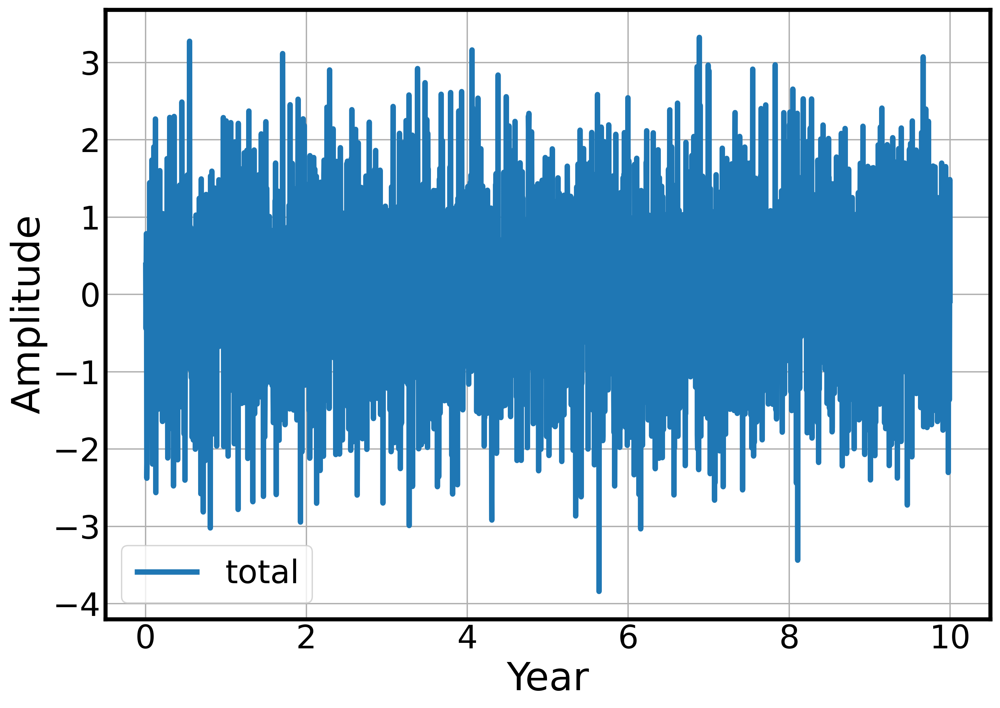

In [77]:
plt.plot(t, total, label='total')
plt.xlabel('Year')
plt.ylabel('Amplitude')
plt.legend()

Преобразование Фурье хорошо реализовано в библиотеке scipy

In [78]:
from scipy import fft

In [79]:
# прямое преобразование Фурье
fft_values = fft.fft(total)

In [80]:
print(fft_values.dtype,fft_values.shape)

complex128 (3650,)


изобразим периодограмму без сглаживания

In [81]:
fft_real = np.abs(fft_values) #амплитуда гармоники 

In [82]:
# и соответствующие частоты
freq_values = fft.fftfreq(N, 1/365)

In [83]:
# согласно документации, частоты хранятся в таком порядке:
# сначало нулевая, затем c шагом 1/N от 1/N до T/2 и потом в обратном порядке со знаком минус
print(freq_values[:3],freq_values[N//2-2:N//2+2],freq_values[-3:])

[0.  0.1 0.2] [ 182.3  182.4 -182.5 -182.4] [-0.3 -0.2 -0.1]


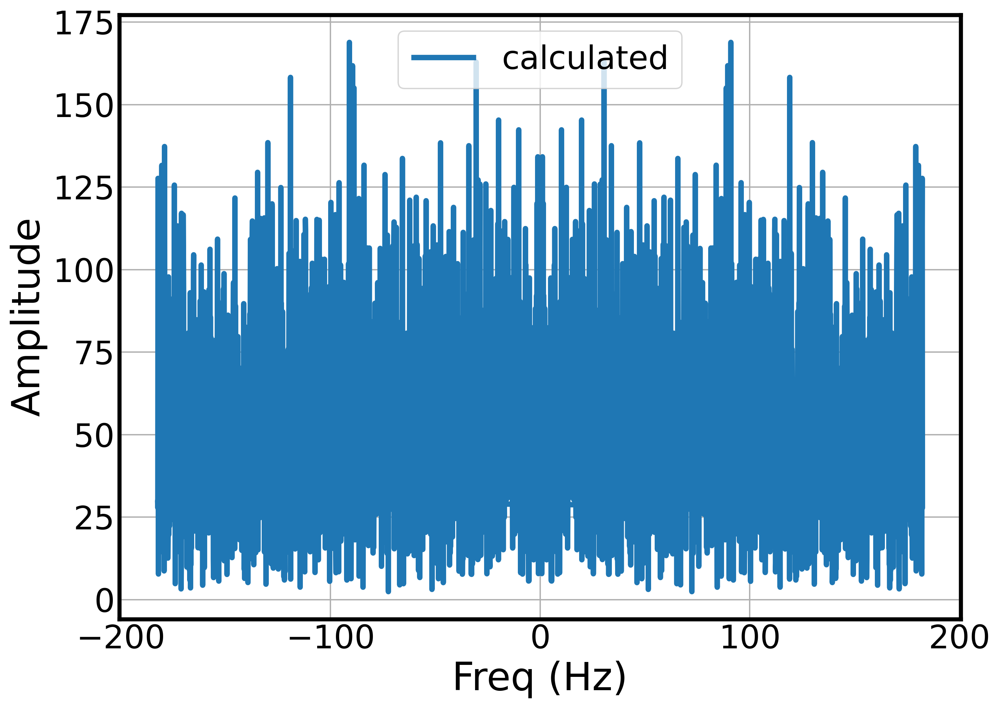

In [84]:
# график периодограммы - для белого шума выглядит также, как и исходный ряд
# Другими словами, такой вр содержит в одинаковом количестве все частоты, подобно тому, 
#как белый цвет содержит в себе все остальные цвета - откуда и название ряда - белый шум
plt.plot(freq_values, fft_real, label='calculated')
plt.xlabel('Freq (Hz)')
plt.ylabel('Amplitude')
plt.legend()

случайное блуждание

In [85]:
total = np.zeros(N)
total += np.cumsum(np.random.normal(size=N))

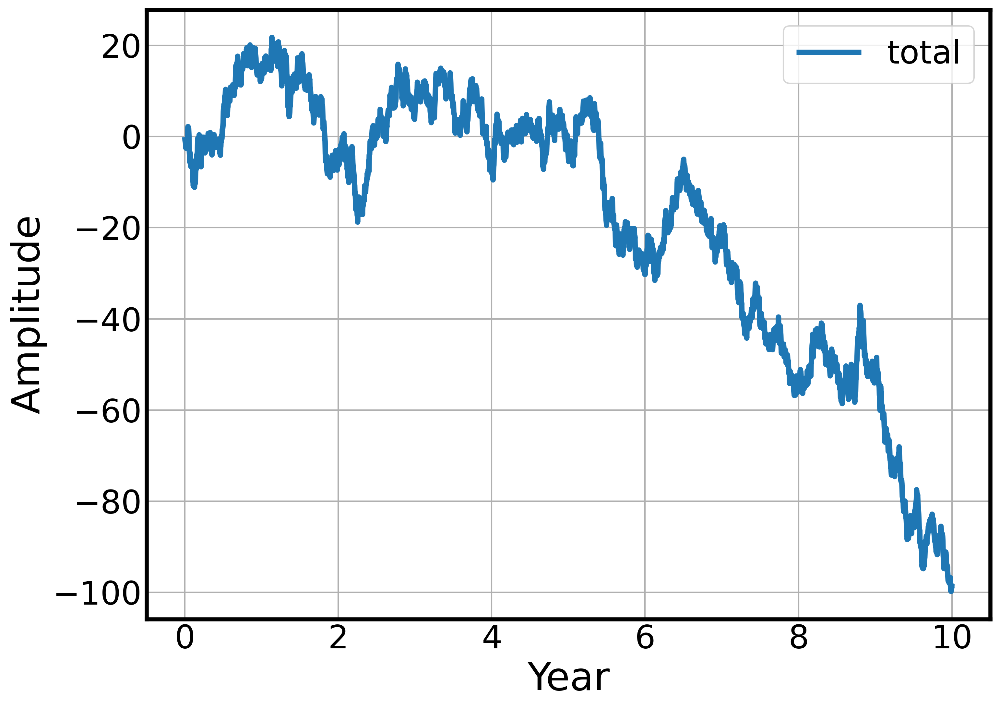

In [86]:
plt.plot(t, total, label='total')
plt.xlabel('Year')
plt.ylabel('Amplitude')
plt.legend()

In [87]:
fft_values = fft.fft(total)
fft_real = np.abs(fft_values) #амплитуда гармоники 

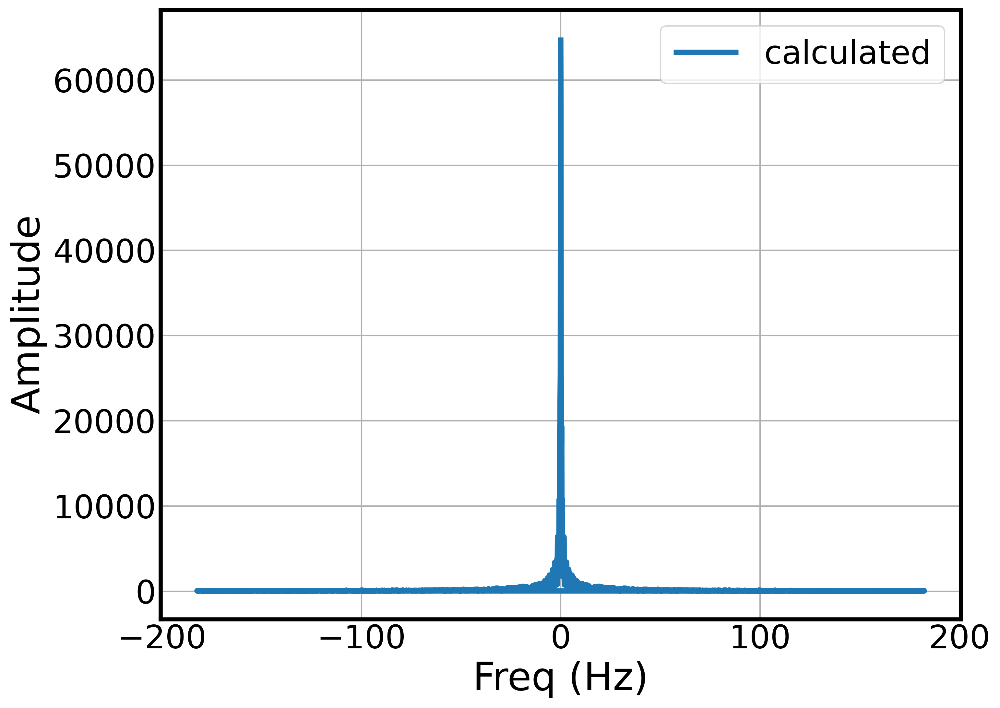

In [88]:
# периодограмма случайного блуждания - пик в 0, и потом быстрое убывание амплитуды с ростом частоты
plt.plot(freq_values, fft_real, label='calculated')
plt.xlabel('Freq (Hz)')
plt.ylabel('Amplitude')
plt.legend()

In [89]:
# амплитуды симметричных частот одинаковы
pd.DataFrame(zip(freq_values, fft_real))

,0,1
0,0.0,64985.694846
1,0.1,58015.910664
2,0.2,25498.465615
3,0.3,22627.973389
4,0.4,17013.287495
...,...,...
3645,-0.5,19354.727904
3646,-0.4,17013.287495
3647,-0.3,22627.973389
3648,-0.2,25498.465615


теперь попробуем смоделировать вр с несколькими детерминированными частотами и шумом

In [90]:
amp = np.array([2, .7, .1, 0.5]) # амплитуды частот
freq = np.array([1, 2, 10, 15]) # частоты - всего 4 частоты

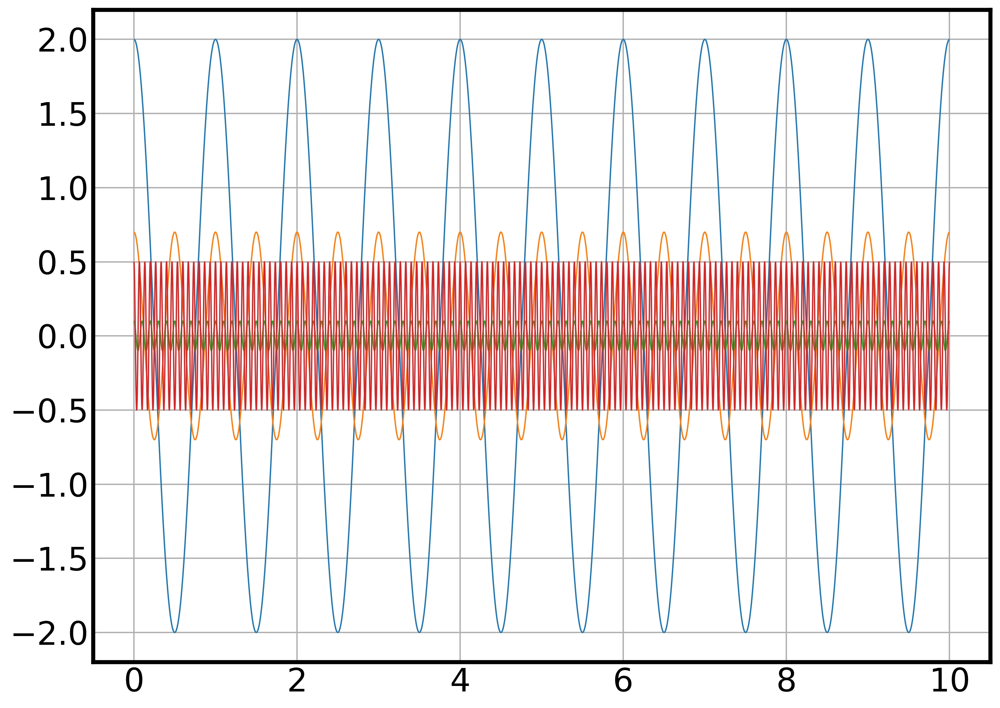

In [91]:
total = np.zeros(N)
components = []

n_freq = len(freq)

# добавляем детерминированные частоты
for i in range(n_freq):
    current = amp[i]*np.cos(2*np.pi*freq[i]*t)
    total += current
    
    components.append(current)
    plt.plot(t, current, label='f='+str(freq[i]), lw=1)

total += np.random.normal(size=N,scale=3) # добавляем шум

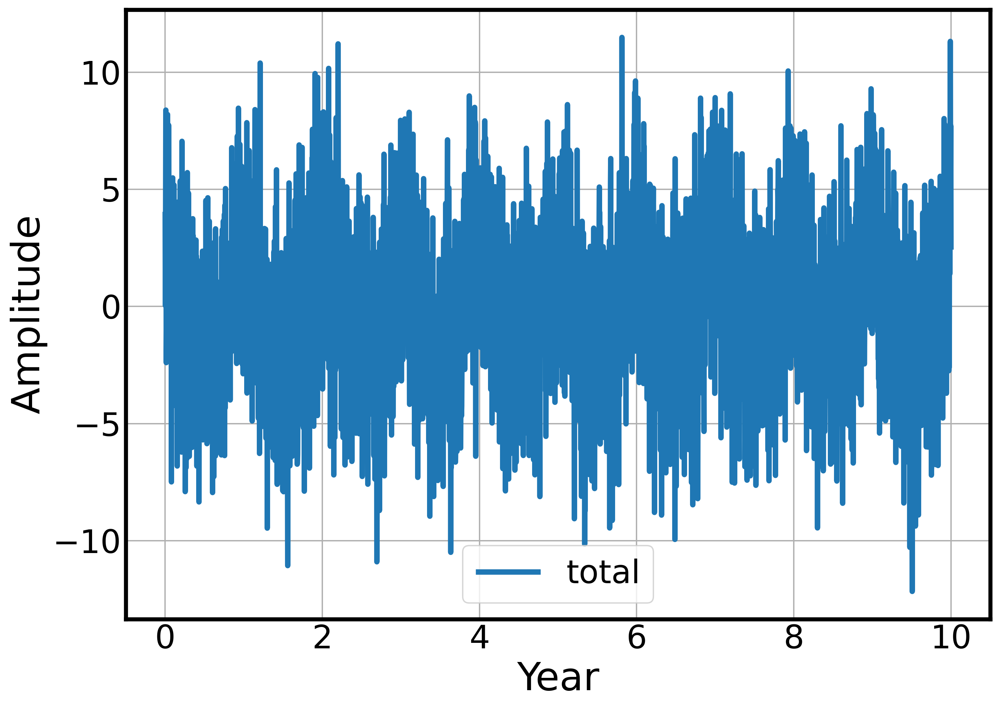

In [92]:
plt.plot(t, total, label='total')
plt.xlabel('Year')
plt.ylabel('Amplitude')
plt.legend()

(0.0, 2.0)

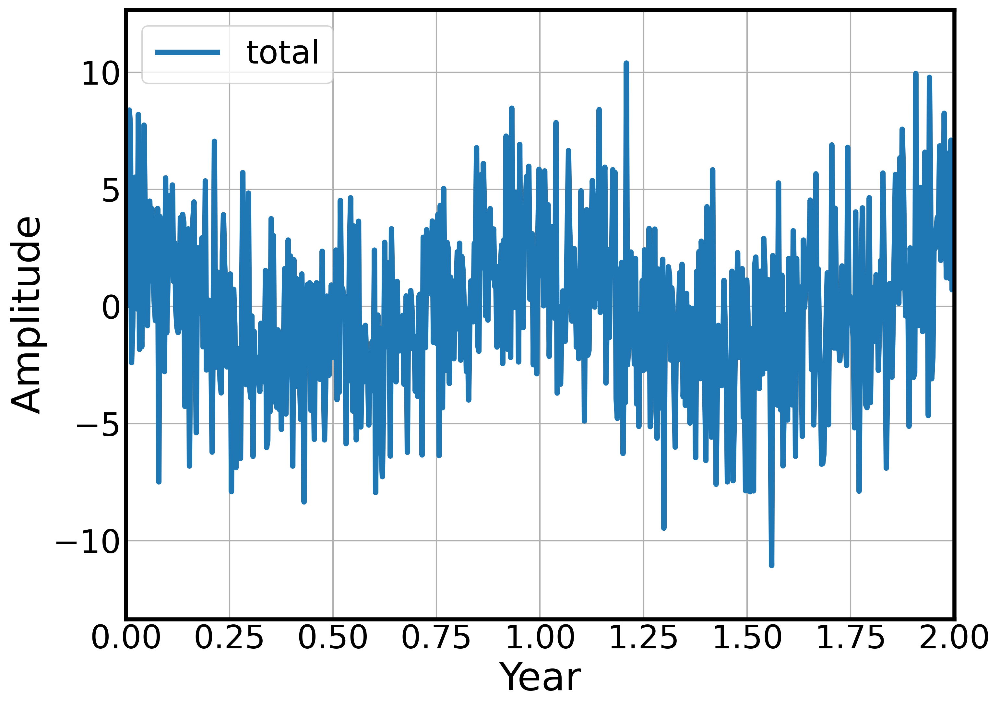

In [93]:
# визуально видно только самую медленную частоту
plt.plot(t, total, label='total')
plt.xlabel('Year')
plt.ylabel('Amplitude')
plt.legend()
plt.xlim(0,2)

In [94]:
fft_values = fft.fft(total)

In [95]:
# нормировка амплитуд для обратного преобразования фурье
fft_real = 2.0/N * np.abs(fft_values)

In [96]:
# большую амплитуду имеет только 6 наблюдений
np.where(fft_real>0.3)

(array([  10,   20,  150, 3500, 3630, 3640]),)

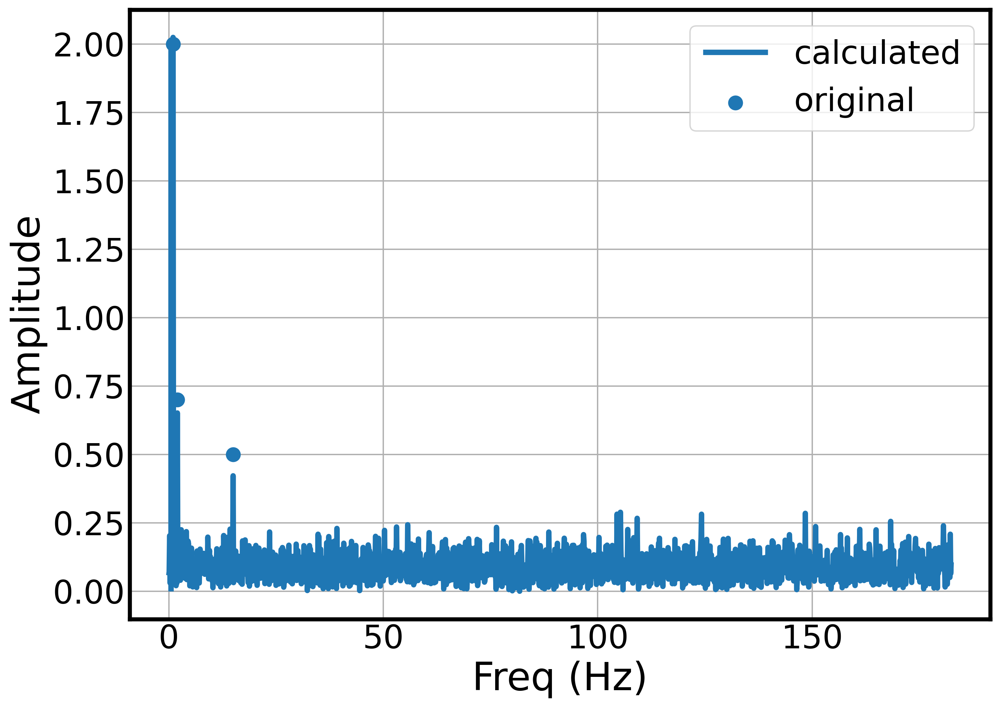

In [97]:
plt.plot(freq_values[0:N//2], fft_real[0:N//2], label='calculated')
plt.scatter(freq, amp, s=100, zorder=3, label='original')
plt.vlines(x=freq_ny,ymin=0,ymax=2)
plt.xlabel('Freq (Hz)')
plt.ylabel('Amplitude')
plt.legend()
#plt.xlim(0,20)

Видим, что несмотря на шум, ряд фурье успешно детектировал 3 из 4 частот в исходном вр. Одну не получилось - амплитуда была слишком маленькой, и она утонула в белом шуме.

## Периодограмма стационарного ряда

In [98]:
Sun = pd.read_csv('data/sun.csv')
Sun['YEAR'] = pd.to_datetime(Sun['YEAR'].astype(int).astype(str) + '-01-01')
Sun.set_index("YEAR",inplace=True)

<Axes: xlabel='YEAR'>

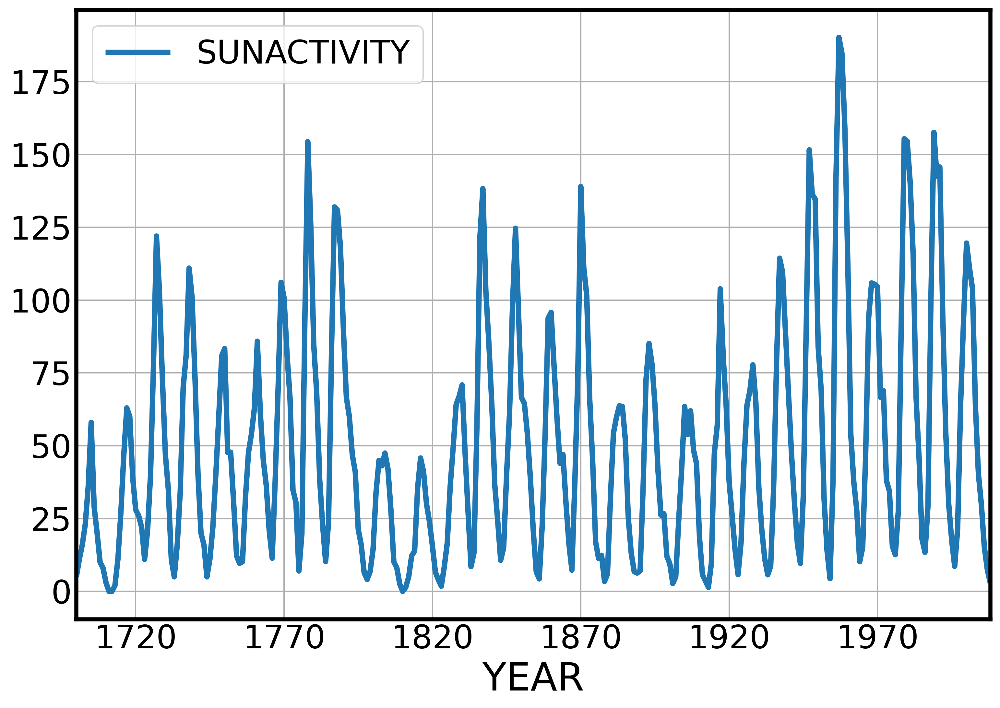

In [99]:
Sun.plot()

In [100]:
# преобразование фурье, частота, амплитуда и фаза комплексных чисел
x_freqdom = fft.fft(Sun.values,axis=0)
N=len(Sun.values)
fourier = pd.DataFrame(x_freqdom)
fourier['freq'] = fft.fftfreq(N,1) 
fourier['amp'] = np.absolute(x_freqdom) / N
fourier['phase'] = np.angle(x_freqdom)

In [101]:
fourier.sort_values(by='amp',ascending=False)

,0,freq,amp,phase
0,15373000000.4-0.0000000j,0.000000,49.752104,-0.000000
281,-4391.782265+1253.691784j,-0.090615,14.780646,2.863525
28,-4391.782265-1253.691784j,0.090615,14.780646,-2.863525
278,3046.408257-1347.458363j,-0.100324,10.780269,-0.416441
31,3046.408257+1347.458363j,0.100324,10.780269,0.416441
280,-641.080451+2575.909730j,-0.093851,8.590569,1.814716
29,-641.080451-2575.909730j,0.093851,8.590569,-1.814716
3,-2218.446615+1360.674113j,0.009709,8.422289,2.591418
306,-2218.446615-1360.674113j,-0.009709,8.422289,-2.591418
26,-2221.097788-384.517889j,0.084142,7.294939,-2.970171


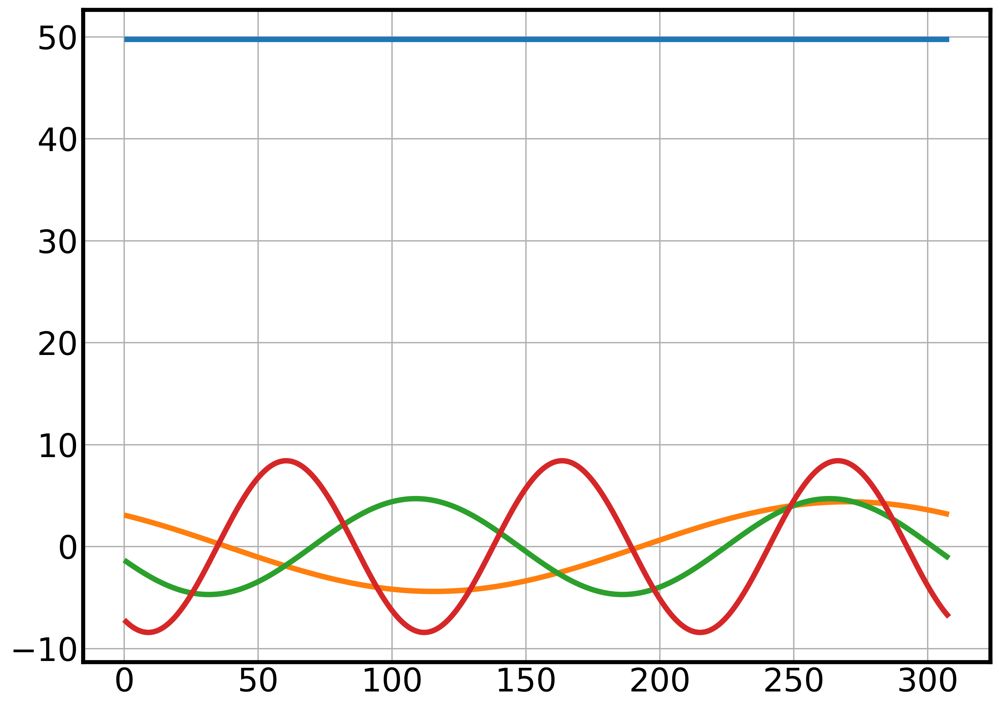

In [102]:
# график первых компонент Фурье
t = np.arange(0, len(Sun))
for i in range(4):
    plt.plot(t, fourier.iloc[i,2] * np.cos(2 * np.pi * fourier.iloc[i,1] * t  + fourier.iloc[i,3]))

In [103]:
fourier.sort_values(by='amp',ascending=False,inplace=True)

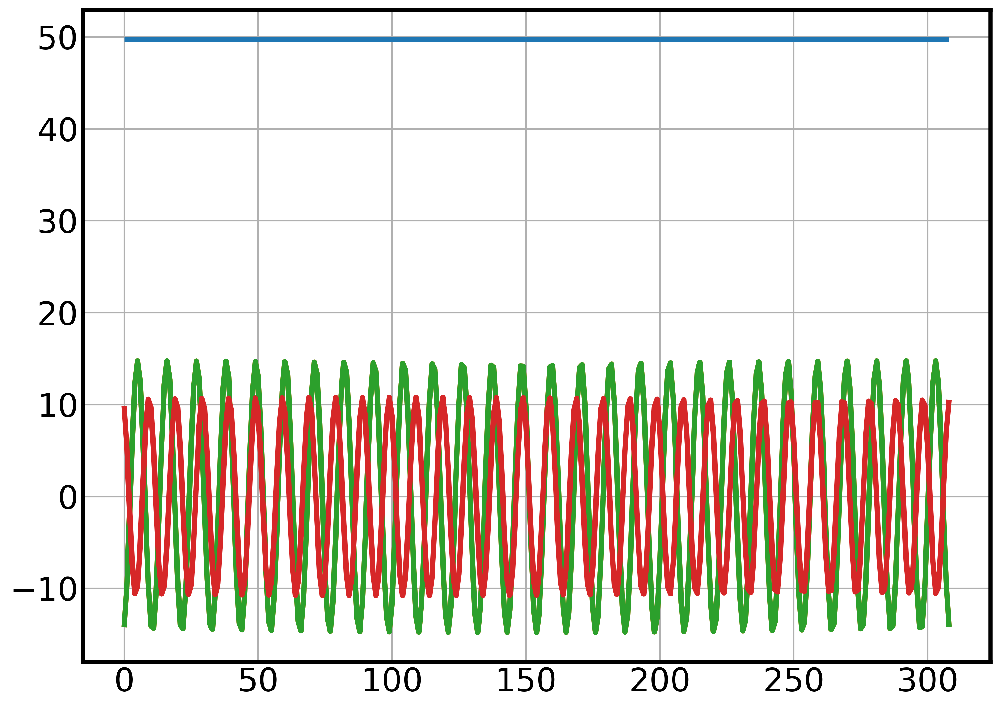

In [104]:
# график первых компонент Фурье по амплитуде
t = np.arange(0, len(Sun))
for i in range(4):
    plt.plot(t, fourier.iloc[i,2] * np.cos(2 * np.pi * fourier.iloc[i,1] * t  + fourier.iloc[i,3]))

In [105]:
N = len(Sun)
fft_values = fft.fft(Sun.values,axis=0)

In [106]:
freq_values = fft.fftfreq(N,)

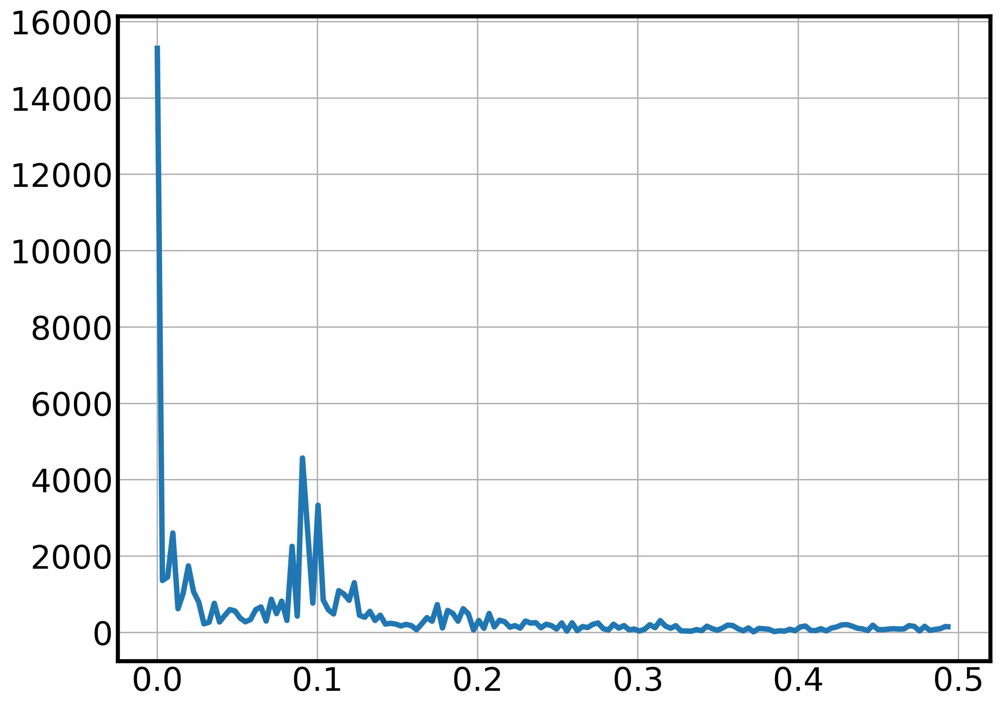

In [107]:
# периодограмма ряда солнечной активности
# основной вклад вност частоты около 0.1
fig, ax = plt.subplots(1)
ax.plot(freq_values[:N//2], np.abs(fft_values[:N//2]));

In [108]:
# фильтр низких частот
filtered = fft_values.copy()
filtered[(np.abs(freq_values) > 0.15)] = 0

In [109]:
# обратное преобразование Фурье
signal_filtered = np.real(fft.ifft(filtered, axis=0))

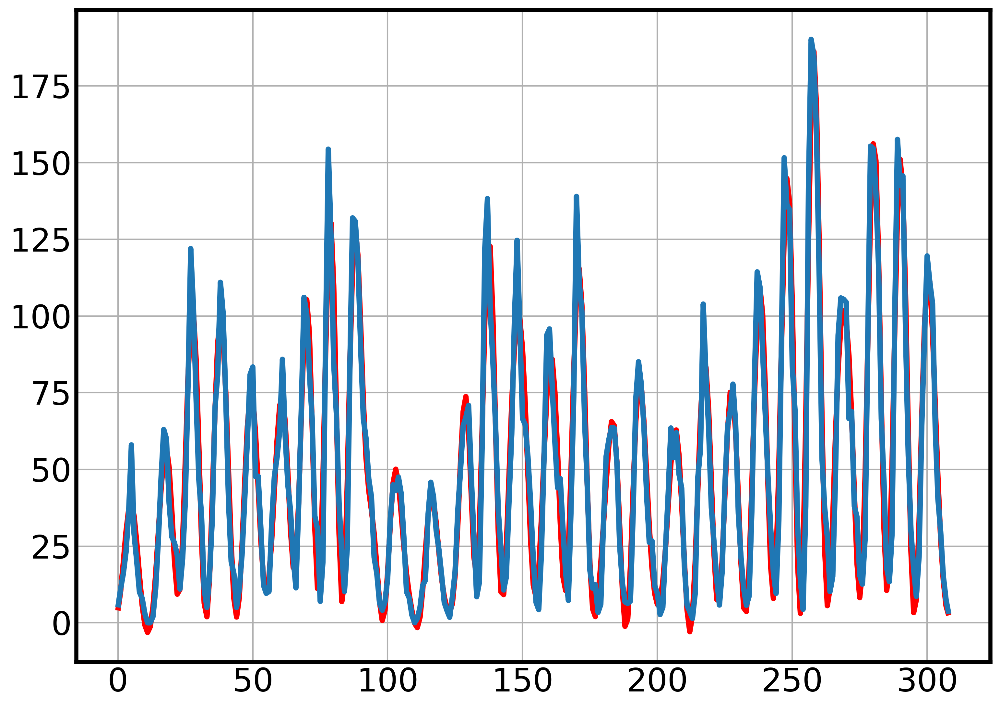

In [110]:
# мы очистили 70% всех частот, при этом вр практически не изменился
plt.plot(signal_filtered,c='red')
plt.plot(Sun.values)

посмотрим, как работает экстраполяция с помощью рядов Фурье в сравнении с моделью ARIMA. Посмотрим на короткий и длительный промежутки времени

In [111]:
from sktime.forecasting.arima import ARIMA

In [112]:
forecaster_short = ARIMA((3,0,3))
forecaster_long = ARIMA((3,0,3))

In [113]:
forecaster_long.fit(Sun.values[:-100])
forecaster_short.fit(Sun.values[:-10])

ARIMA(order=(3, 0, 3))

In [114]:
def fourierExtrapolation(x, n_predict, n_harm = 20, inner_freq = 1.0):
    """
    Функция для экстраполяции рядов Фурье. По вр х делает предикт на n_predict шагов
    с помощью топ n_harm гармоник по амплитуде.
    Возвращает исходный ряд + экстраполяцию на n_predict шагов
    
    https://gist.github.com/tartakynov/83f3cd8f44208a1856ce
    """
    n = x.size
    t = np.arange(0, n)

    x_freqdom = fft.fft(x,axis=0)  # x in frequency domain
    f = fft.fftfreq(n,inner_freq)              # frequencies
    indexes = list(range(n))
    # sort indexes by frequency, lower -> higher
    indexes.sort(key=lambda i: np.absolute(f[i]))

    t = np.arange(0, n + n_predict)
    restored_sig = np.zeros(t.size)
    for i in indexes[:1 + n_harm * 2]:
        ampli = np.absolute(x_freqdom[i]) / n   # amplitude
        phase = np.angle(x_freqdom[i])          # phase
        restored_sig += ampli * np.cos(2 * np.pi * f[i] * t * inner_freq  + phase)
    return restored_sig

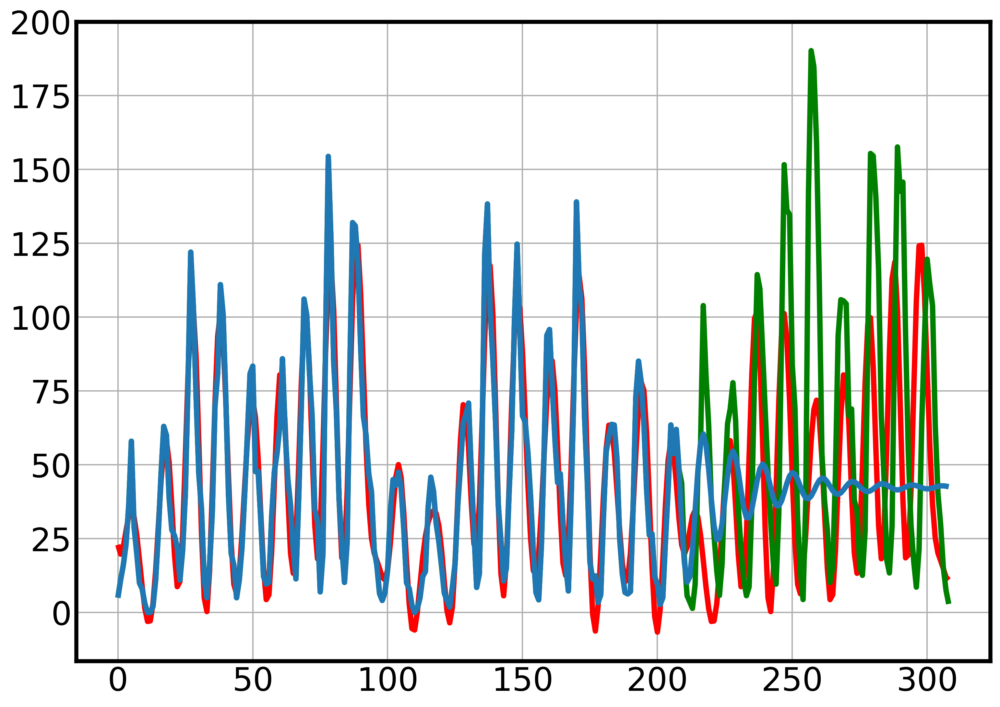

In [115]:
# графическое сравнение прогнозов на длинном промежутке
plt.plot(fourierExtrapolation(Sun.values[:-100,:],100,25,1),c='red')
plt.plot(Sun.values,c='green')
plt.plot(np.r_[Sun.values[:-100,:],forecaster_long.predict(fh=list(range(1,101)))])

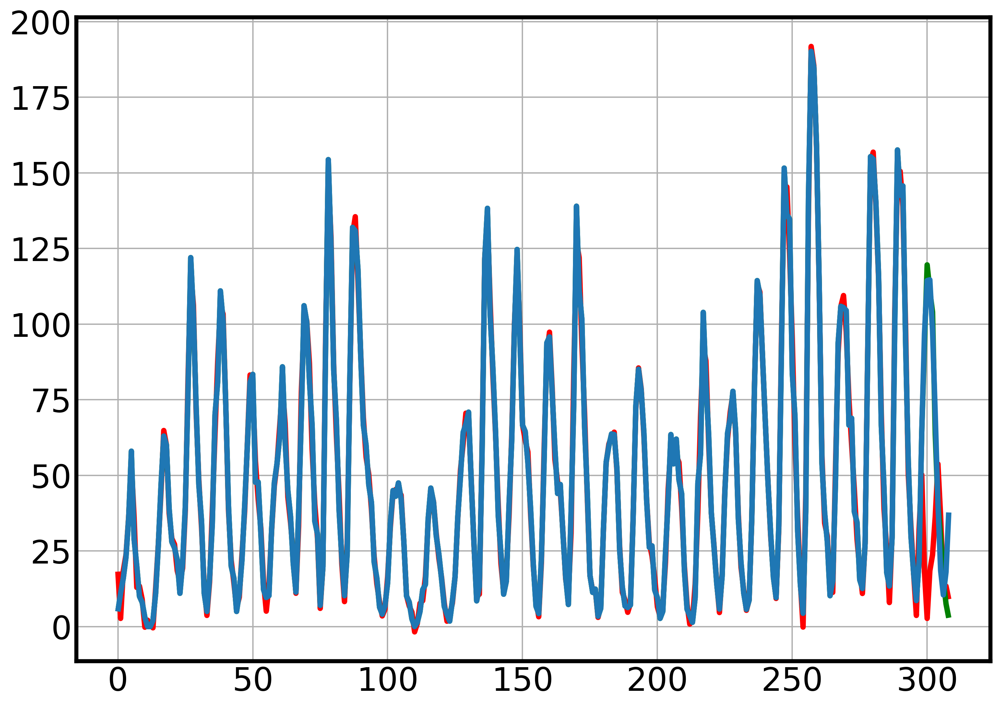

In [116]:
# графическое сравнение прогнозов на коротком промежутке
plt.plot(fourierExtrapolation(Sun.values[:-10,:],10,100,1),c='red')
plt.plot(Sun.values,c='green')
plt.plot(np.r_[Sun.values[:-10,:],forecaster_short.predict(fh=list(range(1,11)))])

сравнение метрик на длинном промежутке - ряды фурье чуть более адекватно описывают вр, хотя далеко от идеального, т.к. у исходного вр непостоянный период колебаний

In [117]:
metrics_report(Sun.values[-100:], 
               fourierExtrapolation(Sun.values[:-100,:],100,25,1)[-100:])

,mean,median,quan_75,quan_95,std
maes,36.242991,28.933119,50.291084,96.977932,29.638263
maes_zero,40.765760,41.350000,52.961000,92.268000,26.244892
mapes,127.256173,55.934436,90.448479,478.778469,265.936246
mapes_zero,238.521466,59.256703,238.611732,994.245614,538.043125
r2,0.068504,0.068504,0.068504,0.068504,0.068504


In [118]:
metrics_report(Sun.values[-100:], 
               forecaster_long.predict(fh=list(range(1,101))))

,mean,median,quan_75,quan_95,std
maes,37.199296,24.476423,54.073517,112.851890,35.105056
maes_zero,40.765760,41.350000,52.961000,92.268000,26.244892
mapes,119.038803,58.789994,80.049732,402.712555,219.074523
mapes_zero,238.521466,59.256703,238.611732,994.245614,538.043125
r2,-0.110965,-0.110965,-0.110965,-0.110965,-0.110965


In [119]:
# при увеличении кол-ва гармоник качество прогноза не улучшается 
# кол-во гармоник - гиперпараметр, который нужно подбирать
metrics_report(Sun.values[-100:], 
               fourierExtrapolation(Sun.values[:-100,:],100,50,1)[-100:])

,mean,median,quan_75,quan_95,std
maes,36.514046,32.366220,51.145228,104.091597,31.133749
maes_zero,40.765760,41.350000,52.961000,92.268000,26.244892
mapes,128.575757,56.163167,90.721978,388.805905,331.189788
mapes_zero,238.521466,59.256703,238.611732,994.245614,538.043125
r2,0.021701,0.021701,0.021701,0.021701,0.021701


сравнение метрик на коротком промежутке - здесь модель arma прогнозирует очень хорошо в отличии от рядов Фурье

In [120]:
metrics_report(Sun.values[-10:], 
               fourierExtrapolation(Sun.values[:-10,:],10,25,1)[-10:])

,mean,median,quan_75,quan_95,std
maes,43.132997,21.774339,81.718970,99.965076,41.570793
maes_zero,39.580000,44.400000,52.005000,58.601000,17.795130
mapes,91.924409,79.371890,89.065843,223.012412,77.711437
mapes_zero,322.398964,48.983684,239.114050,1366.474483,599.689243
r2,-0.844792,-0.844792,-0.844792,-0.844792,-0.844792


In [121]:
metrics_report(Sun.values[-10:], 
               forecaster_short.predict(fh=list(range(1,11))))

,mean,median,quan_75,quan_95,std
maes,8.629853,5.640685,9.509721,24.248072,9.777230
maes_zero,39.580000,44.400000,52.005000,58.601000,17.795130
mapes,143.838987,7.959195,36.247241,723.933112,373.915975
mapes_zero,322.398964,48.983684,239.114050,1366.474483,599.689243
r2,0.913312,0.913312,0.913312,0.913312,0.913312


## Периодограмма нестационарного ряда

In [122]:
airline = pd.read_csv('data/international-airline-passengers.csv', sep=';')
airline['Month'] = pd.to_datetime(airline['Month']+'-01')
airline.set_index('Month', inplace=True)

<Axes: xlabel='Month'>

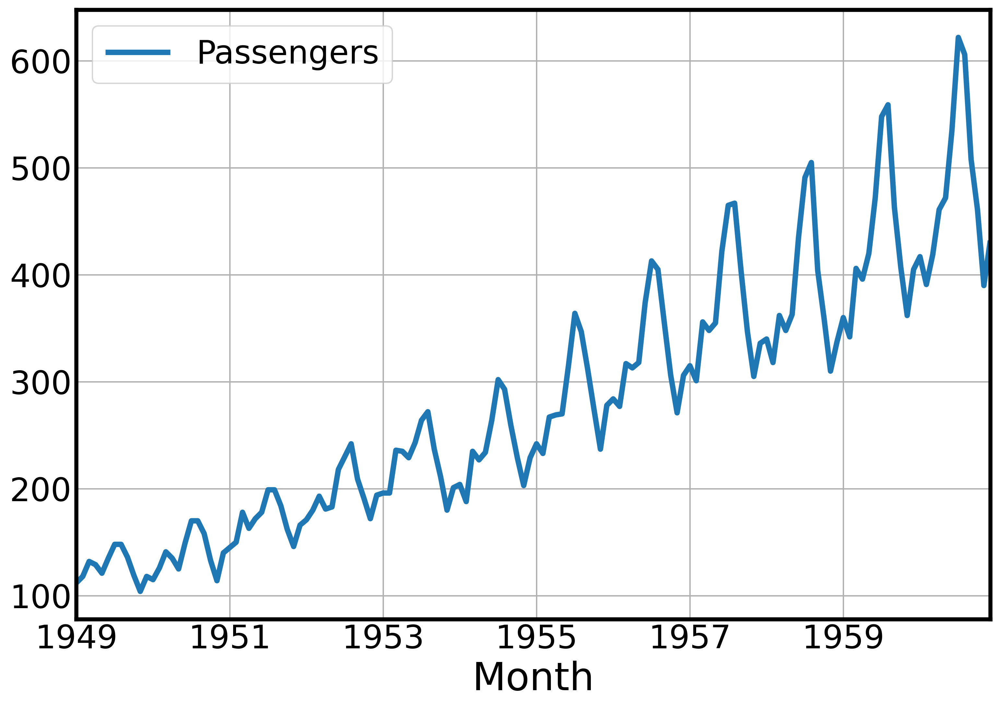

In [123]:
airline.plot()

In [124]:
# прямое преобразование фурье
fft_values = fft.fft(airline,axis=0)
N = len(airline)
freq_values = fft.fftfreq(N, 1/12) # все частоты по оси х отображаются относительно частоты "1 раз за год"

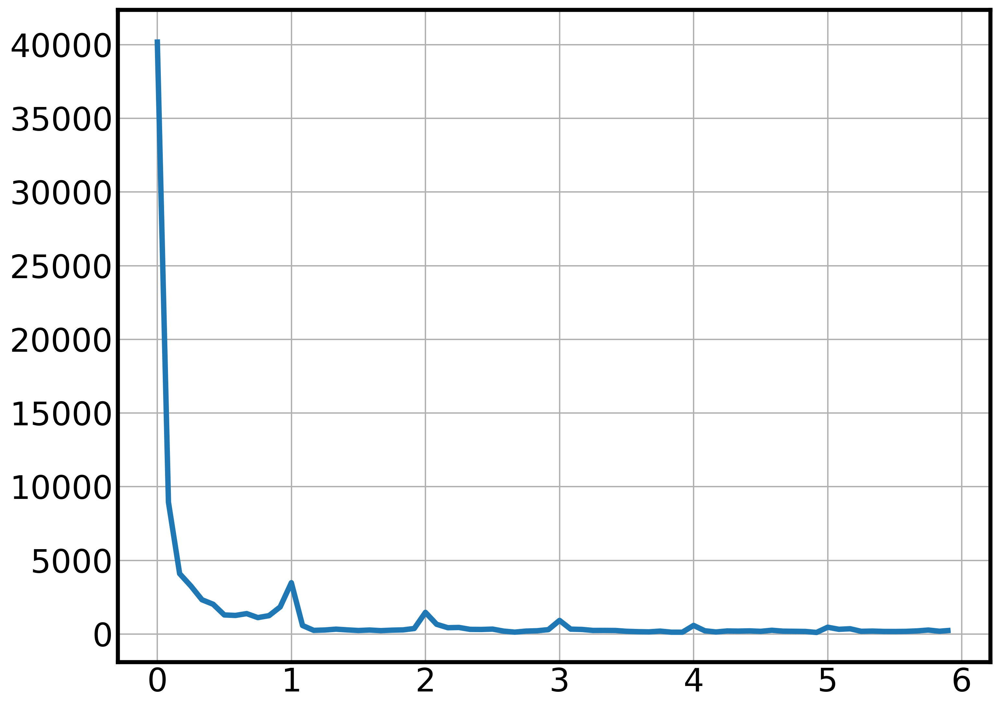

In [125]:
# периодограмма ряда авиаперевозок - видим пик около 0 и в частотах, кратных частоте "1 раз за год"
fig, ax = plt.subplots(1)
ax.plot(freq_values[:N//2], np.abs(fft_values[:N//2]));

In [126]:
# фильтр высоких частот + преобразование Фурье
filtered = fft_values.copy()
filtered[(np.abs(freq_values) > 3.3)] = 0
signal_filtered = np.real(fft.ifft(filtered, axis=0))

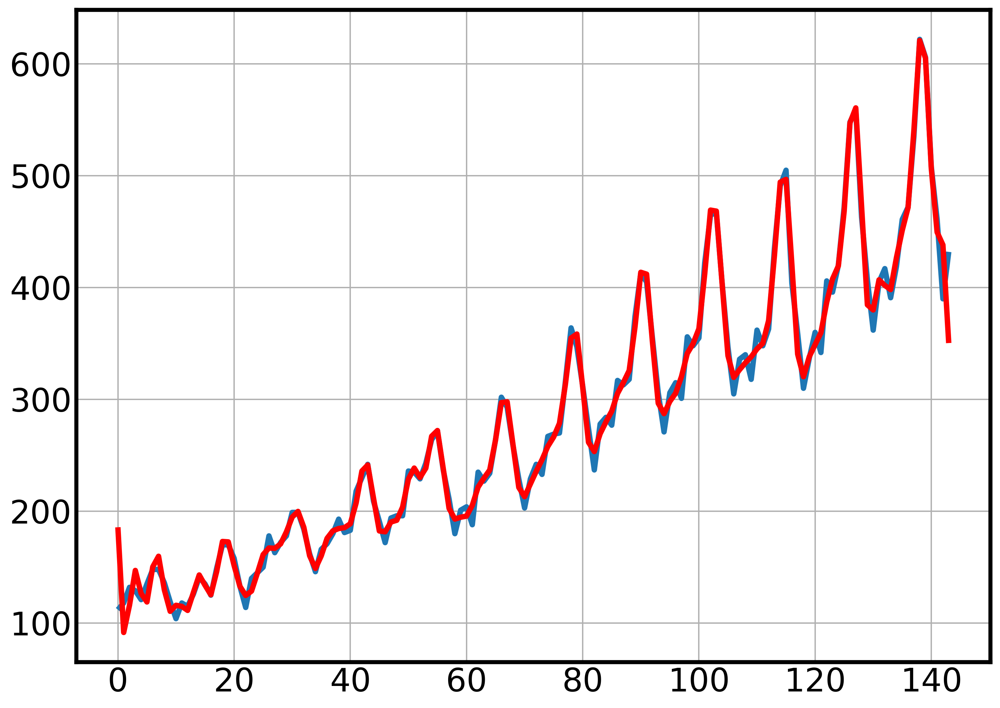

In [127]:
#у восстановленного ряда наблюдаются сильные отклонения на краях отрезка (0,T)
plt.plot(airline.values)
plt.plot(signal_filtered,c='red')

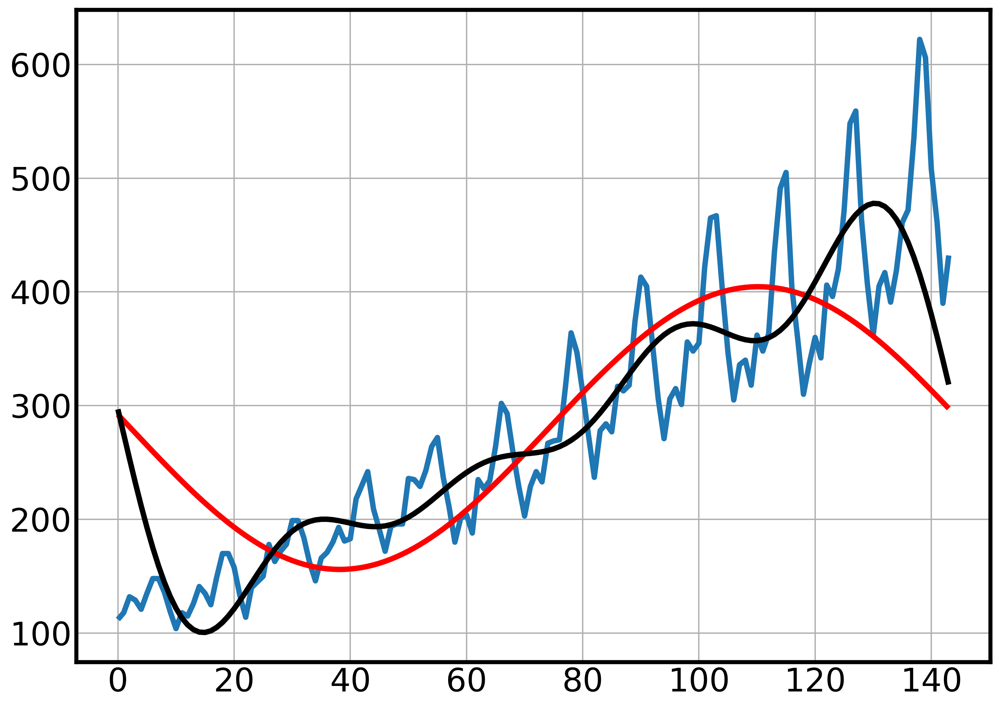

In [128]:
#потому что ряды фурье не умеют описывать трендовую компоненту
plt.plot(airline.values)
plt.plot(fourierExtrapolation(airline.values,0,1,1),c='red')
plt.plot(fourierExtrapolation(airline.values,0,4,1),c='black')

Для преобразования вр в частотный спектр обязательно в первую очередь нужно провести операцию детрендирования!

Давайте это сделаем

In [129]:
from sktime.transformations.series.boxcox import BoxCoxTransformer
def BC_inverse(y, lam, sig):
    """Back transform Box-Cox with Bias correction.
    See https://robjhyndman.com/hyndsight/backtransforming
    """
    if lam == 0:
        return np.exp(y) * (1 + 0.5 * sig**2)
    else:
        res = np.power(lam*y + 1., 1/lam)
        res *= (1 + 0.5 * sig**2 * (1 - lam) / (lam*y + 1.)**2)
        return res

In [130]:
from sktime.transformations.series.detrend import Detrender
from sktime.forecasting.trend import PolynomialTrendForecaster

In [131]:
# также помимо операции детрендирования обеспечим одинаковую амплитуду для сезонных колебаний
transformer = BoxCoxTransformer(method = "guerrero",sp=12)
airline_box = transformer.fit_transform(airline)

In [132]:
# выделяем из ряда полиномный тренд
airline_detrend = Detrender(PolynomialTrendForecaster(degree=2)).fit_transform(airline_box)

<Axes: xlabel='Month'>

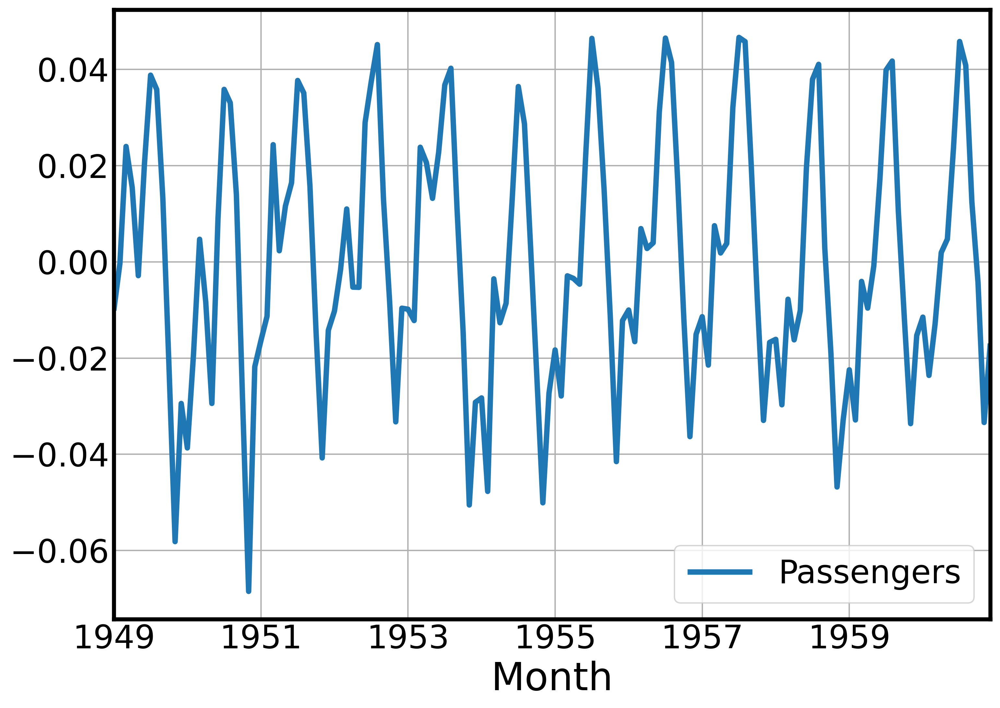

In [133]:
airline_detrend.plot()

In [134]:
# прямое преобразование фурье
fft_values = fft.fft(airline_detrend,axis=0)
N = len(airline)
freq_values = fft.fftfreq(N, 1/12)

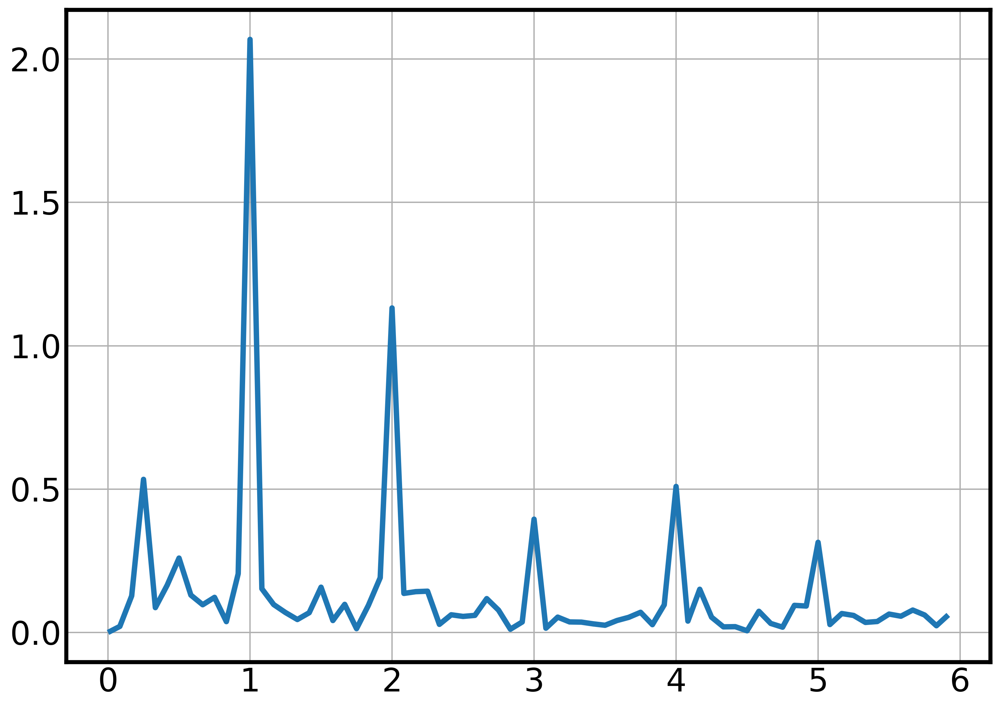

In [135]:
# теперь основные пики на периодограмме связаны с сезонностью
fig, ax = plt.subplots(1)
ax.plot(freq_values[:N//2], np.abs(fft_values[:N//2]));

In [136]:
# фильтр высоких частот + преобразование Фурье
filtered = fft_values.copy()
filtered[np.abs(freq_values) > 4.5] = 0
signal_filtered = np.real(fft.ifft(filtered,axis=0))

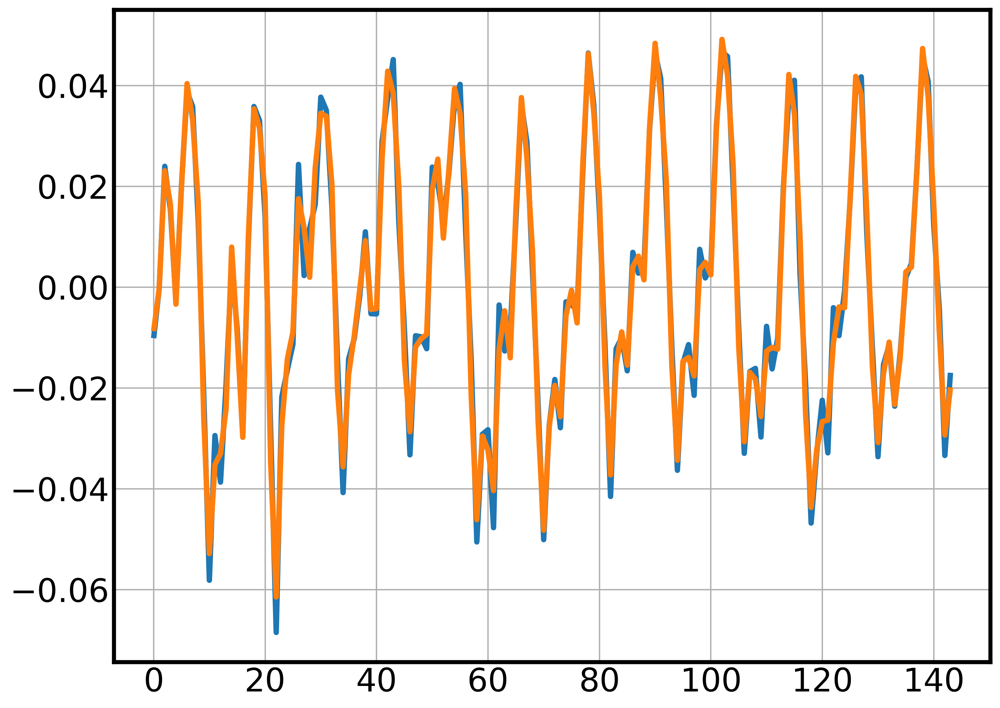

In [137]:
# достаточно точно восстановили исходный ряд
plt.plot(airline_detrend.values)
plt.plot(signal_filtered)

Теперь попробуем с помощью рядов Фурье смоделировать сезонную компоненту

In [138]:
# Выделим в test последние 40 наблюдений
test_idx = 40

In [139]:
# попробуем тем же методом посчитать сезонность
ses_extra = fourierExtrapolation(airline_detrend.iloc[:-test_idx],test_idx,25)

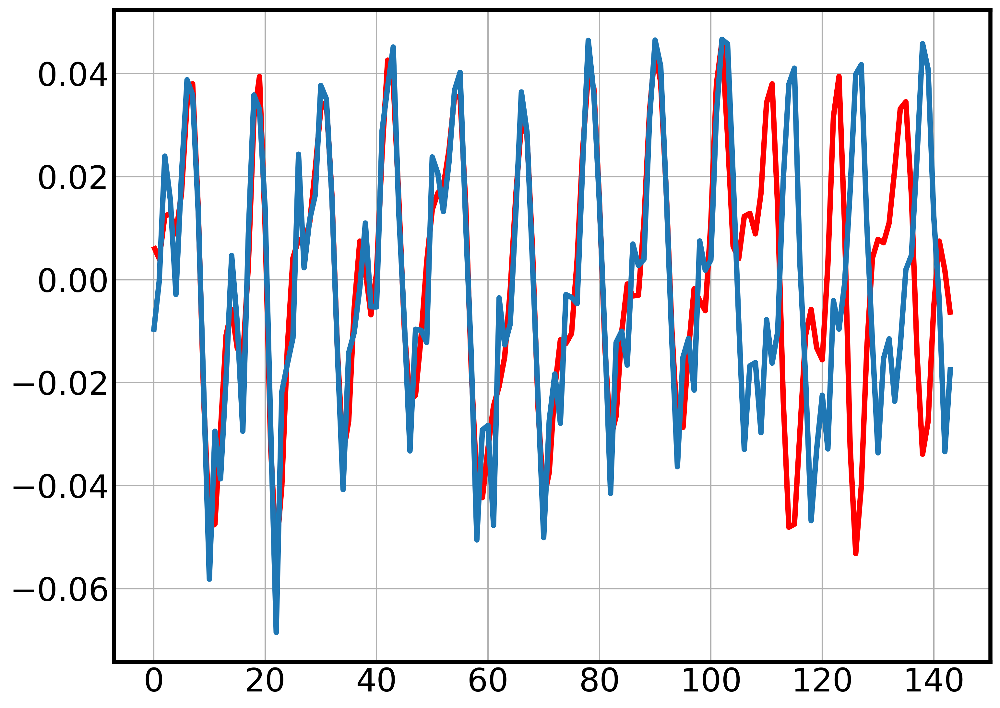

In [140]:
# на графике с фактической и прогнозной сезонностью видим, что предсказанная сезонность начинает
# смещаться относительно фактической
plt.plot(ses_extra,c='red')
plt.plot(airline_detrend.values)

Этот эффект называется "растекание частоты" (frequency leakage). Его причина - длина ряда не кратна частоте сезонной компоненты

In [141]:
# последнее наблюдение заканчивается на 8 месяце, а не на 12
airline_detrend.iloc[:-test_idx].tail()

,Passengers
Month,
1957-04-01,0.001847
1957-05-01,0.003823
1957-06-01,0.032087
1957-07-01,0.046659
1957-08-01,0.045790


In [142]:
# оценим самый значимые по амплитуде частоты
x_freqdom = fft.fft(airline_detrend.iloc[:-test_idx],axis=0)
n = len(airline_detrend.iloc[:-test_idx])
fourier = pd.DataFrame(x_freqdom)
fourier['freq'] = fft.fftfreq(n,1/12) 
fourier['amp'] = np.absolute(x_freqdom) / n
fourier['phase'] = np.angle(x_freqdom)

In [143]:
# видно, что эти частоты близки к значениям, кратным 1/12, но не равны ей
fourier.sort_values(by='amp',ascending=False)

,0,freq,amp,phase
9,-0.766744+0.847216j,1.038462,0.010987,2.306376
95,-0.766744-0.847216j,-1.038462,0.010987,-2.306376
96,0.573020+0.450659j,-0.923077,0.007010,0.666432
8,0.573020-0.450659j,0.923077,0.007010,-0.666432
87,0.580520-0.058797j,-1.961538,0.005610,-0.100939
17,0.580520+0.058797j,1.961538,0.005610,0.100939
18,-0.450340-0.142307j,2.076923,0.004541,-2.835523
86,-0.450340+0.142307j,-2.076923,0.004541,2.835523
102,0.219248-0.374480j,-0.230769,0.004173,-1.041126
2,0.219248+0.374480j,0.230769,0.004173,1.041126


давайте попробуем оценить сезонность с целым периодом

In [144]:
# Выделим в test последние 36 наблюдений
test_idx_full = 36

In [145]:
# обучающая выборка заканчивается в декабре
airline_detrend.iloc[:-test_idx_full].tail()

,Passengers
Month,
1957-08-01,0.045790
1957-09-01,0.020041
1957-10-01,-0.007978
1957-11-01,-0.032958
1957-12-01,-0.016740


In [146]:
# оценим самый значимые по амплитуде частоты
x_freqdom = fft.fft(airline_detrend.iloc[:-test_idx_full],axis=0)
n = len(airline_detrend.iloc[:-test_idx_full])
fourier = pd.DataFrame(x_freqdom)
fourier['freq'] = fft.fftfreq(n,1/12) 
fourier['amp'] = np.absolute(x_freqdom) / n
fourier['phase'] = np.angle(x_freqdom)

In [147]:
# здесь частоты кратны 1/12
fourier.sort_values(by='amp',ascending=False)

,0,freq,amp,phase
9,-1.480701-0.409829j,1.000000,0.014226,-2.871572
99,-1.480701+0.409829j,-1.000000,0.014226,2.871572
90,0.545992+0.702154j,-2.000000,0.008236,0.909866
18,0.545992-0.702154j,2.000000,0.008236,-0.909866
36,0.085397+0.420513j,4.000000,0.003973,1.370442
72,0.085397-0.420513j,-4.000000,0.003973,-1.370442
106,0.082721-0.412352j,-0.222222,0.003894,-1.372816
2,0.082721+0.412352j,0.222222,0.003894,1.372816
81,-0.096010-0.283278j,-3.000000,0.002770,-1.897571
27,-0.096010+0.283278j,3.000000,0.002770,1.897571


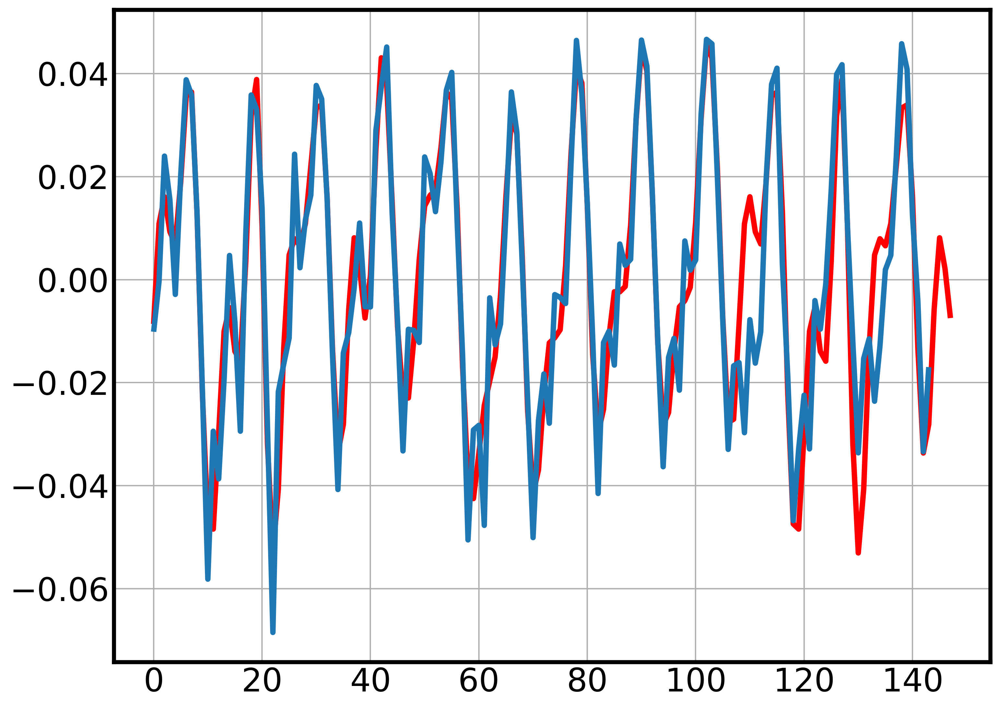

In [148]:
# на графике с фактической и прогнозной сезонностью видим, что смещение между линиями пропало
plt.plot(fourierExtrapolation(airline_detrend.iloc[:-test_idx_full],40,25),c='red')
plt.plot(airline_detrend.values)

Ряды Фурье применяется для прогнозирования рядом с длинными сезонностями, например, для моделирования годовой сезонности в подневных данных, чтобы не вводить 365 бинарных переменных. Для более коротких сезонностей можно использовать бинарные переменные. При моделировании сезонности с помощью рядов Фурье стоит всегда помнить про необходимость детрендировать ряд, а также про эффект "растекания частоты".

# Прогнозирование с помощью stl+arma

## Прогнозирование с помощью stl

В этом разделе разберем, как делать простые прогнозы на основе stl-разложения и как их можно улучшать с помощью моделей ARMA

In [149]:
airline = pd.read_csv('data/international-airline-passengers.csv', sep=';')
airline['Month'] = pd.to_datetime(airline['Month']+'-01')
airline.set_index('Month', inplace=True)

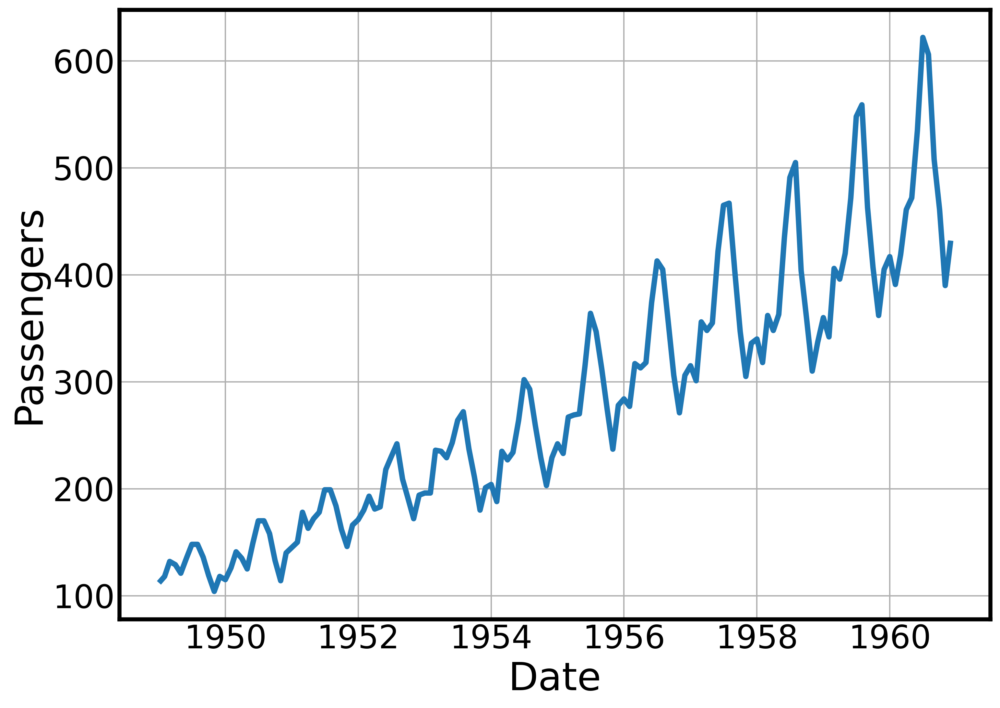

In [150]:
fig, ax = plt.subplots(1, 1)
ax.plot(airline.index, airline['Passengers'])
ax.set_xlabel('Date')
ax.set_ylabel('Passengers');

In [151]:
# вспомним, как выглядит stl-разложение для вр
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.seasonal import STL

In [152]:
mod_decomp = STL(airline,period=12).fit()

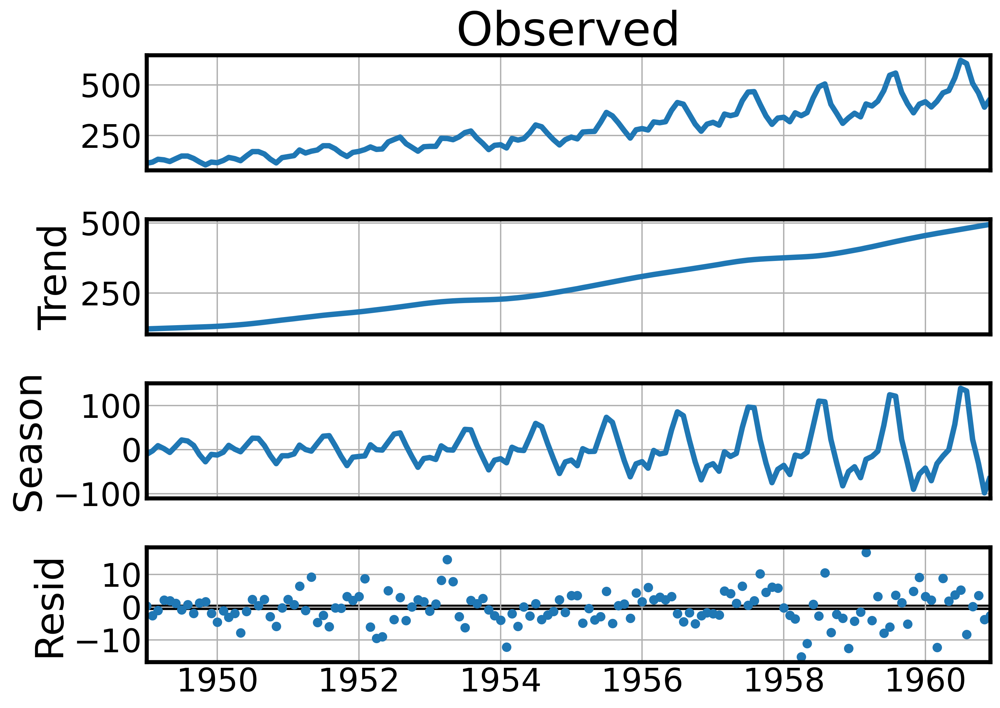

In [153]:
mod_decomp.plot();

In [154]:
# будем оценивать качество прогноза начиная со start_idx
# на короткий (1 месяц) и на длинный (12 мес) периоды
start_idx = len(mod_decomp.trend.loc[:"1954-12-01"])
short_step = 1
long_step = 12

сначала соберем прогноз для тренда

<Axes: xlabel='Month'>

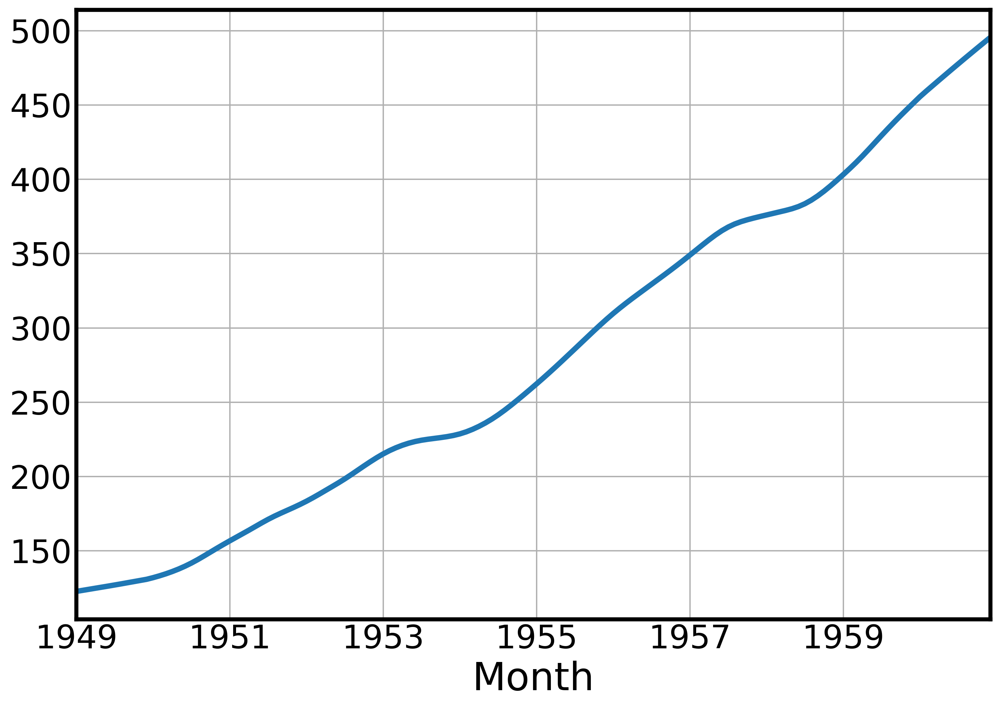

In [155]:
mod_decomp.trend.plot()

In [156]:
# для прогнозирования будем использовать метод интерполяции из библиотеки scipy
from scipy.interpolate import interp1d

def trend_progn(y,
               forecast_length=12):
    
    """
    функция прогнозирования трендовой компоненты на forecast_length шагов вперед с помощью экстраполяции
    """
    
    x= list(range(len(y))) # переменная х - время (от 0 до T (длины вр))
    func = interp1d(x,y,kind='linear',fill_value="extrapolate")
    
    # возвращаем прогноз с момента времени T+1 до T+forecast_length
    return func(list(range(len(y)+1,len(y)+forecast_length + 1))).reshape(-1,1)

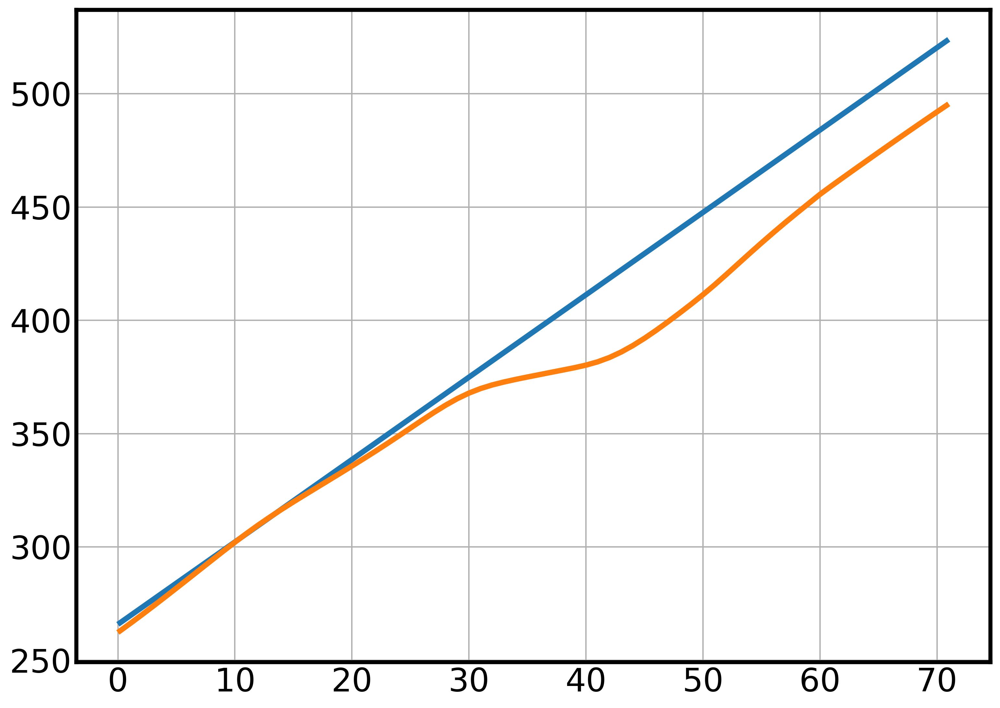

In [157]:
# график трендовой компоненты и его экстраполяционной оценки
plt.plot(trend_progn(mod_decomp.trend.iloc[:start_idx],forecast_length=72))
plt.plot(mod_decomp.trend.iloc[start_idx:,].values)

давайте теперь оценим сезонную компоненту

In [158]:
def naive_season_progn(seasonal,
                       forecast_horizont=12,
                       period=12,):
    
    """
    функция для прогнозирования сезонной компоненты, которая возвращает
    последнее известное значение для каждой компоненты
    """
    #i%period нужен, если forecast_horizont>12, чтобы точно вернулась последняя сезонная компонента
    return np.array([seasonal[-period+i%period] for i in range(forecast_horizont)]).reshape(-1,1)

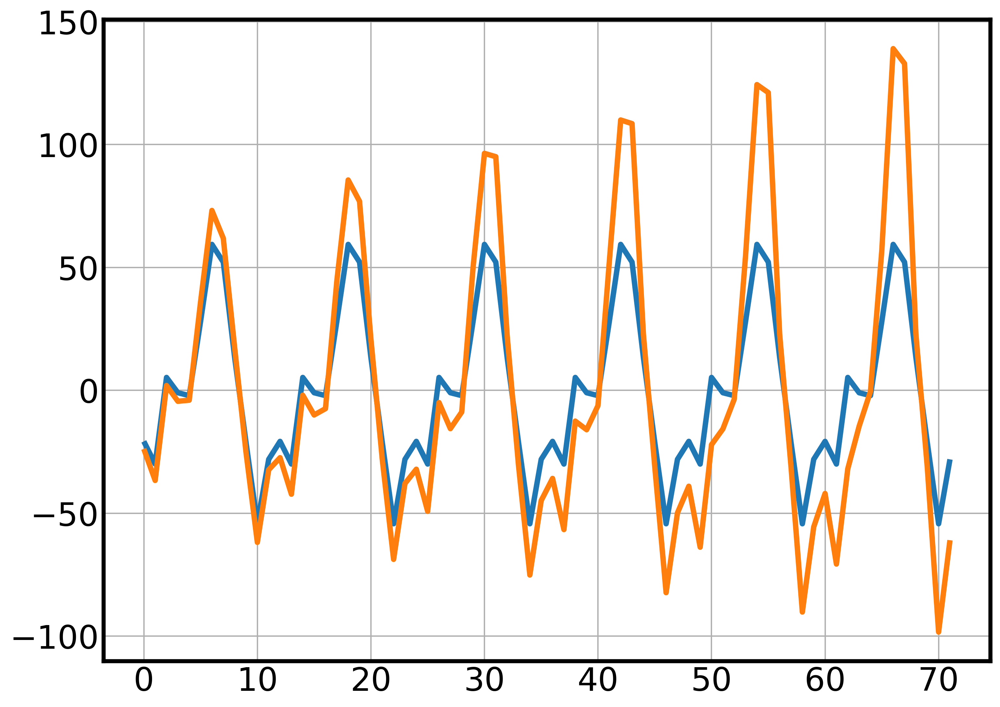

In [159]:
# график сезонной компоненты и его экстраполяционной оценки
plt.plot(naive_season_progn(mod_decomp.seasonal.iloc[:start_idx],forecast_horizont=72))
plt.plot(mod_decomp.seasonal.iloc[start_idx:,].values)

теперь давайте попробуем оценить качество на коротком и длинном отрезке времени

In [160]:
progn_df = pd.DataFrame(airline).copy()

In [161]:
# инициализируем колонки под оценки тренда и сезонности на коротком и длинном отрезке времени
progn_df["trend_est_short"] = 0
progn_df["seasonal_est_short"] = 0
progn_df["trend_est_long"] = 0
progn_df["seasonal_est_long"] = 0

In [162]:
# в цикле с шагом long_step делаем stl-разложение и прогнозируем на следующие long_step месяцев
len_df = len(progn_df)

i = start_idx
forecast_length=long_step
while i < len_df:
    
    mod_decomp = STL(airline['Passengers'].iloc[:i],period=12,robust=True).fit()
    
    progn_df.loc[progn_df.index[i:i+forecast_length],"trend_est_long"]  = \
    trend_progn(mod_decomp.trend,forecast_length)
    progn_df.loc[progn_df.index[i:i+forecast_length],"seasonal_est_long"] = \
    naive_season_progn(mod_decomp.seasonal,forecast_length,12)
    
    
    i+=long_step

In [163]:
# в цикле с шагом short_step делаем stl-разложение и прогнозируем на следующие short_step месяцев
forecast_length=short_step
i = start_idx
while i < len_df:
    
    mod_decomp = STL(airline['Passengers'].iloc[:i],period=12,robust=True).fit()
    
    progn_df.loc[progn_df.index[i:i+forecast_length],"trend_est_short"]  = \
    trend_progn(mod_decomp.trend,forecast_length)
    progn_df.loc[progn_df.index[i:i+forecast_length],"seasonal_est_short"] = \
    naive_season_progn(mod_decomp.seasonal,forecast_length,12)
    
    
    i+=short_step

<Axes: xlabel='Month'>

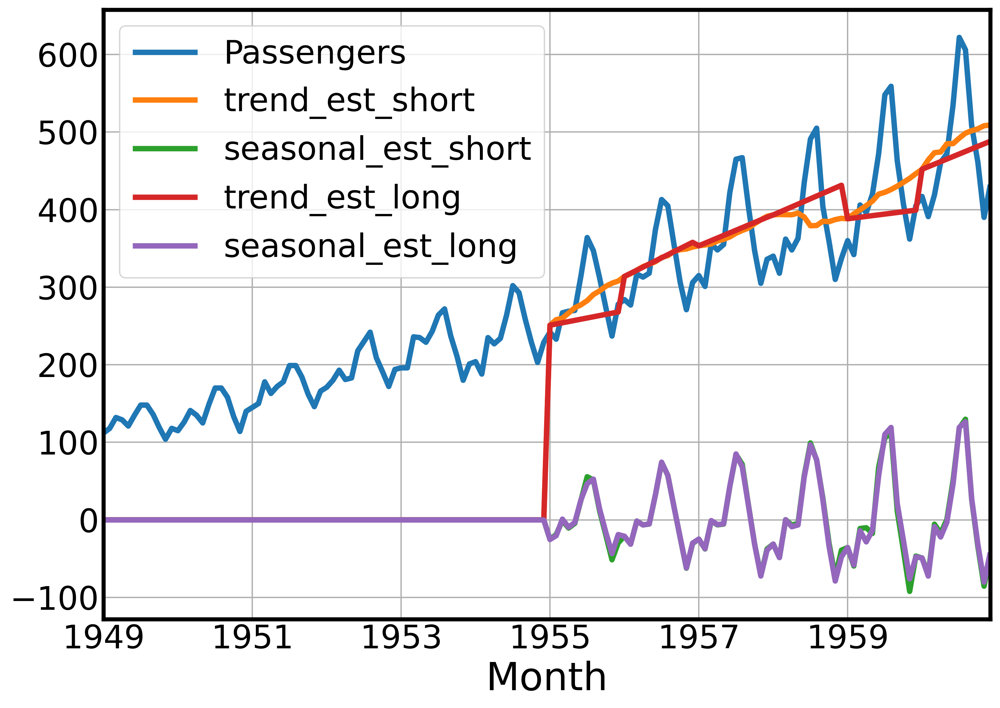

In [164]:
progn_df.plot()

In [165]:
# возьмем остатки моделей
progn_df['resid_short'] = progn_df['Passengers'] - progn_df['trend_est_short'] - progn_df['seasonal_est_short'] 
progn_df['resid_long'] = progn_df['Passengers'] - progn_df['trend_est_long'] - progn_df['seasonal_est_long'] 

resid_long = progn_df[progn_df['trend_est_long']>0].resid_long
resid_short = progn_df[progn_df['trend_est_long']>0].resid_short

<Axes: xlabel='Month'>

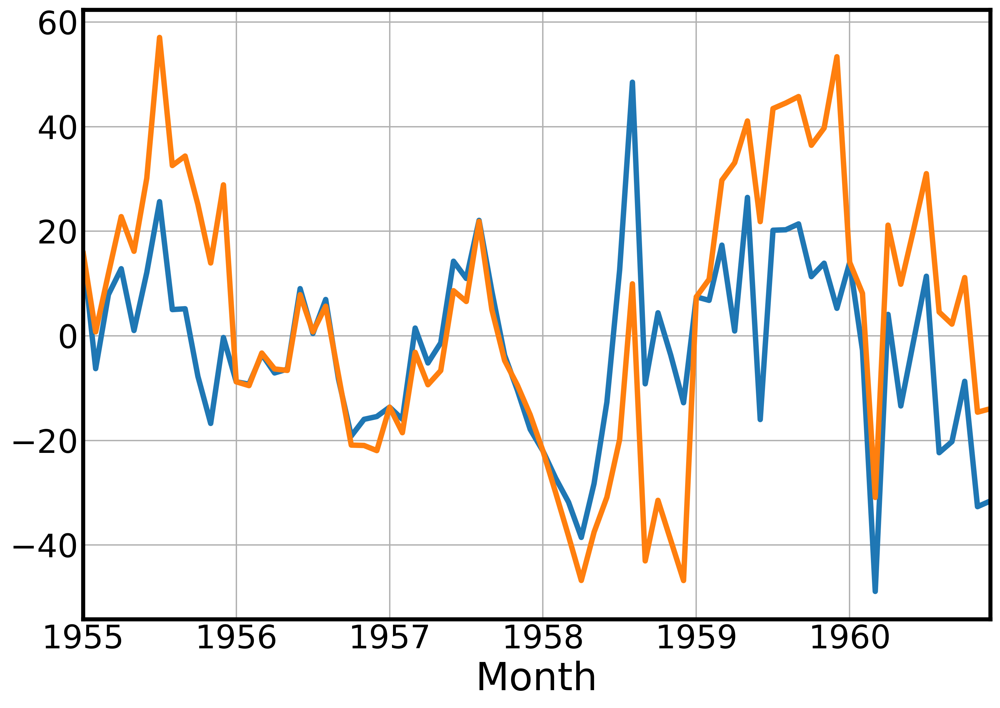

In [166]:
# несмотря на разницу промежутков, остатки выглядят очень похожими
resid_short.plot()
resid_long.plot()

проверка остатков говорит о стационарности и наличии автокореляции, значит их можно попробовать смоделировать моделью arma

In [167]:
check_fit(resid_long)

{'mean_resids': 3.531460041430556,
 'mean_t': 1.1780103203353567,
 'mean_pval': 0.2427258704905348,
 'stationary_t': -2.2432148475475318,
 'stationary_pval': 0.8090636907632192,
 'autocor_pval': False,
 'norm_t': 0.9856151938438416,
 'norm_pval': 0.5851964950561523,
 'heteroscedasticity_t': 2.6243464131543184,
 'heteroscedasticity_pval': 0.10973259029159411,
 'check_result': False}

In [168]:
check_fit(resid_short)

{'mean_resids': -2.370117332565222,
 'mean_t': -1.1729273301489052,
 'mean_pval': 0.24474511567648924,
 'stationary_t': -3.65263582885573,
 'stationary_pval': 0.9951690930495268,
 'autocor_pval': False,
 'norm_t': 0.9912790656089783,
 'norm_pval': 0.9040928483009338,
 'heteroscedasticity_t': 5.745655002317776,
 'heteroscedasticity_pval': 0.019202638024366406,
 'check_result': False}

Оценим качество моделей - видно, что даже такими простыми методами мы добились медианной ape не больше 5% даже при прогнозировании на год вперед!

In [169]:
progn_df['trend_ses_short_progn'] = progn_df.trend_est_short+progn_df.seasonal_est_short
progn_df['trend_ses_long_progn'] = progn_df.trend_est_long+progn_df.seasonal_est_long

In [170]:
metrics_report(progn_df.iloc[start_idx:].Passengers,progn_df.iloc[start_idx:]['trend_ses_short_progn'])

,mean,median,quan_75,quan_95,std
maes,13.649908,11.745598,18.194936,32.187126,10.523337
maes_zero,69.235340,60.194444,95.652778,163.155556,51.094907
mapes,3.645182,3.025528,4.838643,8.664590,2.668137
mapes_zero,18.991833,18.247573,25.276736,40.880138,14.080202
r2,0.959891,0.959891,0.959891,0.959891,0.959891


In [171]:
metrics_report(progn_df.iloc[start_idx:].Passengers,progn_df.iloc[start_idx:]['trend_ses_long_progn'])

,mean,median,quan_75,quan_95,std
maes,21.077768,19.169670,31.121046,46.213328,14.462875
maes_zero,69.235340,60.194444,95.652778,163.155556,51.094907
mapes,5.734287,4.654066,8.809926,12.869401,3.881310
mapes_zero,18.991833,18.247573,25.276736,40.880138,14.080202
r2,0.911707,0.911707,0.911707,0.911707,0.911707


##  Комбинация stl+arma

давайте попробуем спрогнозировать остатки с помощью модели arma

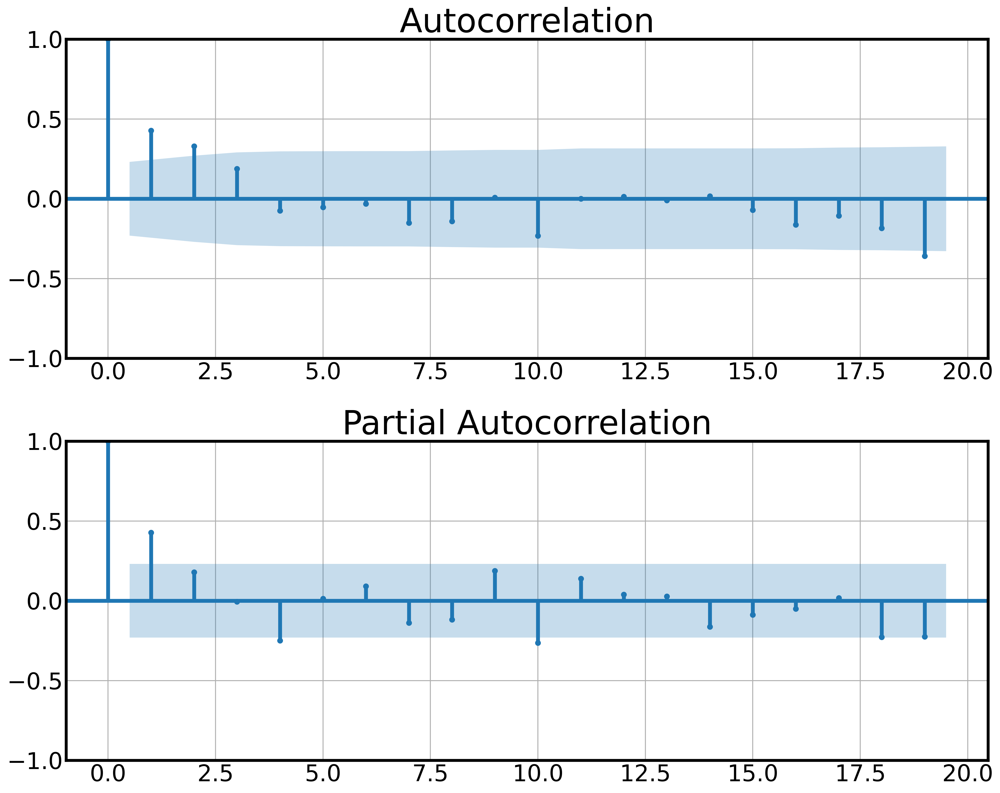

In [172]:
# подберем максимальные значения для p и q для остатков прогноза на 1 месяц
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(resid_short,ax=ax[0]);
tsaplots.plot_pacf(resid_short,ax=ax[1]);

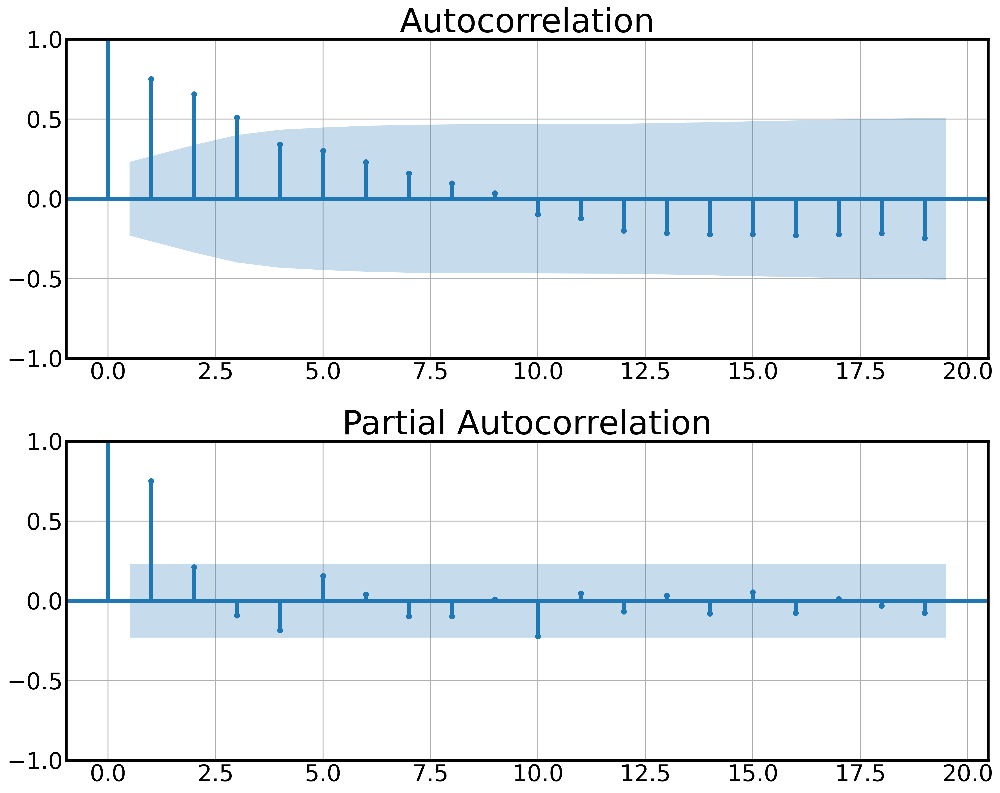

In [173]:
# подберем максимальные значения для p и q для остатков прогноза на 12 месяцев
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(resid_long,ax=ax[0]);
tsaplots.plot_pacf(resid_long,ax=ax[1]);

оценим оптимальные arma

In [174]:
arma_short = calc_optimum_arma(resid_short,1,2)[1]
arma_long = calc_optimum_arma(resid_long,1,3)[1]

6
8


In [175]:
arma_short.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                   72
Model:               SARIMAX(0, 0, 1)   Log Likelihood                -301.076
Date:                Thu, 02 May 2024   AIC                            608.151
Time:                        22:58:39   BIC                            614.981
Sample:                    01-01-1955   HQIC                           610.870
                         - 12-01-1960                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     -2.3662      2.486     -0.952      0.341      -7.239       2.506
ma.L1          0.3308      0.100      3.309      0.001       0.135       0.527
sigma2       250.5705     40.029      6.260      0.000     172.114     329.027
===================================================================================
Ljung-Box (L1) (Q):                   0.39   Jarque-Bera (JB):                 0.17
Prob(Q):                              0.53   Prob(JB):                         0.92
Heteroskedasticity (H):               3.45   Skew:                             0.02
Prob(H) (two-sided):                  0.00   Kurtosis:                         3.24
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [176]:
arma_long.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                   72
Model:               SARIMAX(1, 0, 0)   Log Likelihood                -304.758
Date:                Thu, 02 May 2024   AIC                            615.515
Time:                        22:58:39   BIC                            622.345
Sample:                    01-01-1955   HQIC                           618.234
                         - 12-01-1960                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.8435      1.940      0.435      0.664      -2.958       4.645
ar.L1          0.7481      0.077      9.721      0.000       0.597       0.899
sigma2       274.8474     42.140      6.522      0.000     192.255     357.440
===================================================================================
Ljung-Box (L1) (Q):                   1.74   Jarque-Bera (JB):                 2.44
Prob(Q):                              0.19   Prob(JB):                         0.30
Heteroskedasticity (H):               2.31   Skew:                            -0.02
Prob(H) (two-sided):                  0.05   Kurtosis:                         3.90
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

в остатках присутствуют автокореляции и гетероскедастичность, но мы это игнорируем

In [177]:
check_fit(arma_short._forecaster.resid())

{'mean_resids': -0.0642906400833579,
 'mean_t': -0.034189679218878596,
 'mean_pval': 0.9728218345932624,
 'stationary_t': -3.476289432810458,
 'stationary_pval': 0.991382674497614,
 'autocor_pval': False,
 'norm_t': 0.9921923279762268,
 'norm_pval': 0.9389683604240417,
 'heteroscedasticity_t': 7.19485825147396,
 'heteroscedasticity_pval': 0.009114314032291272,
 'check_result': False}

In [178]:
check_fit(arma_long._forecaster.resid())

{'mean_resids': -0.1338539315224294,
 'mean_t': -0.06787517300181205,
 'mean_pval': 0.9460757886516791,
 'stationary_t': -3.934422451604093,
 'stationary_pval': 0.998204373958969,
 'autocor_pval': True,
 'norm_t': 0.9818862676620483,
 'norm_pval': 0.38711780309677124,
 'heteroscedasticity_t': 2.9922687341489826,
 'heteroscedasticity_pval': 0.08807014002404367,
 'check_result': True}

In [179]:
# выделим еще 24 наблюдения для обучения модели arma
start_idx_arma = start_idx+24

In [180]:
# в цикле с шагом long_step обучаем arma_long модель на остатках от stl-разложения
# и прогнозируем на следующие long_step месяцев
len_df = len(progn_df)

i = start_idx_arma
forecast_length=long_step
while i < len_df:
    
    
    model = ARIMA(arma_long._forecaster.order)
    
    model.fit(resid_long.iloc[:i-start_idx].values)
    
    progn_df.loc[progn_df.index[i:i+forecast_length],"resid_est_long"]  = \
    model.predict(list(range(1,forecast_length+1,1)))
    
    i+=long_step

In [181]:
# в цикле с шагом short_step обучаем arma_short модель на остатках от stl-разложения
# и прогнозируем на следующие short_step месяцев

i = start_idx_arma
forecast_length=short_step
while i < len_df:
    
    
    model = ARIMA(arma_short._forecaster.order)
    
    model.fit(resid_short.iloc[:i-start_idx].values)
    
    progn_df.loc[progn_df.index[i:i+forecast_length],"resid_est_short"]  = \
    model.predict(list(range(1,forecast_length+1,1)))
    
    i+=short_step

In [184]:
# прогнозы с добавлением модели arma
progn_df['trend_ses_resid_short_progn'] =progn_df['trend_ses_short_progn']+progn_df.resid_est_short
progn_df['trend_ses_resid_long_progn'] =progn_df['trend_ses_long_progn']+progn_df.resid_est_long

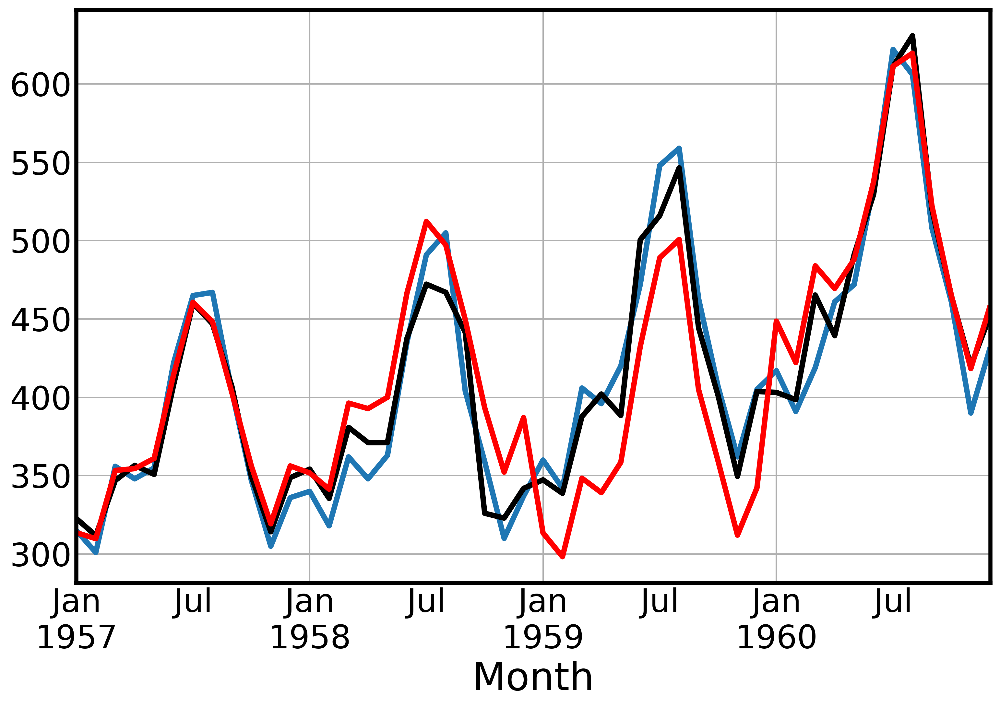

In [185]:
progn_df.iloc[start_idx_arma:].Passengers.plot();
progn_df.iloc[start_idx_arma:].trend_ses_resid_short_progn.plot(c='black');
progn_df.iloc[start_idx_arma:].trend_ses_resid_long_progn.plot(c='red');

Оценим качество моделей - видно, что при прогнозе на 1 шаг вперед добавление arma пусть немного, но улучшило все метрики, кроме медианы


In [186]:
metrics_report(progn_df.iloc[start_idx_arma:].Passengers,progn_df.iloc[start_idx_arma:].trend_ses_short_progn)

,mean,median,quan_75,quan_95,std
maes,15.740335,13.521693,21.558074,36.486785,11.608432
maes_zero,62.372396,55.979167,81.020833,141.670833,46.785800
mapes,3.862072,3.386186,4.870890,9.315924,2.882537
mapes_zero,15.182974,14.538044,21.882168,33.473894,10.416522
r2,0.937068,0.937068,0.937068,0.937068,0.937068


In [187]:
metrics_report(progn_df.iloc[start_idx_arma:].Passengers,progn_df.iloc[start_idx_arma:].trend_ses_resid_short_progn)

,mean,median,quan_75,quan_95,std
maes,15.313576,12.712395,20.183170,35.831657,10.783347
maes_zero,62.372396,55.979167,81.020833,141.670833,46.785800
mapes,3.705082,3.482185,4.703223,8.668787,2.513183
mapes_zero,15.182974,14.538044,21.882168,33.473894,10.416522
r2,0.942263,0.942263,0.942263,0.942263,0.942263


А вот для длинного периода прогнозирование добавление arma только ухудшило исходный прогноз

In [188]:
metrics_report(progn_df.iloc[start_idx_arma:].Passengers,progn_df.iloc[start_idx_arma:].trend_ses_long_progn)

,mean,median,quan_75,quan_95,std
maes,23.073792,20.735183,36.711616,46.417791,14.776593
maes_zero,62.372396,55.979167,81.020833,141.670833,46.785800
mapes,5.763189,4.608552,8.809926,12.981244,3.852225
mapes_zero,15.182974,14.538044,21.882168,33.473894,10.416522
r2,0.876327,0.876327,0.876327,0.876327,0.876327


In [189]:
metrics_report(progn_df.iloc[start_idx_arma:].Passengers,progn_df.iloc[start_idx_arma:].trend_ses_resid_long_progn)

,mean,median,quan_75,quan_95,std
maes,28.726488,27.539866,45.832920,60.607643,20.355945
maes_zero,62.372396,55.979167,81.020833,141.670833,46.785800
mapes,7.161455,7.261168,11.902640,14.793433,5.097442
mapes_zero,15.182974,14.538044,21.882168,33.473894,10.416522
r2,0.795986,0.795986,0.795986,0.795986,0.795986
